# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels , n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float() , y.float()) , dim = 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = n_classes + z_dim
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0170234419107436, discriminator loss: 0.27086681680381297


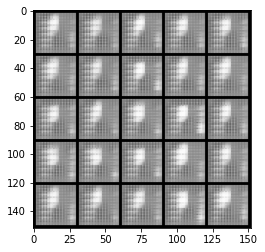

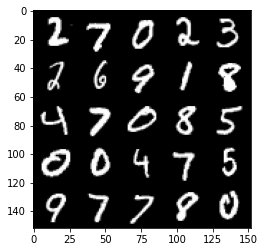

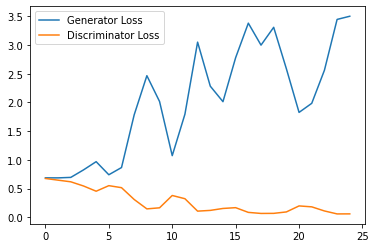

Step 1000: Generator loss: 4.414401249885559, discriminator loss: 0.05472766612423584


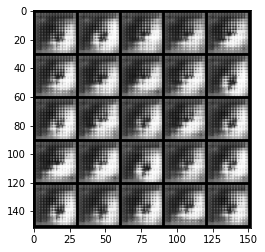

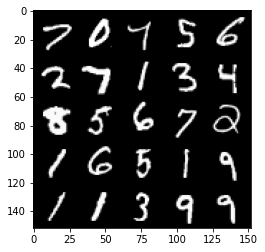

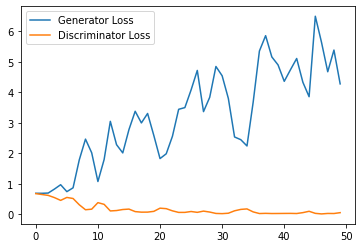

Step 1500: Generator loss: 5.15207133102417, discriminator loss: 0.04068307246407494


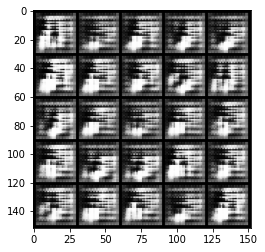

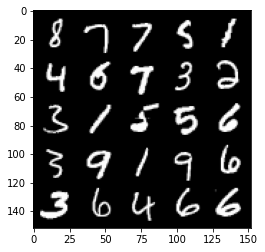

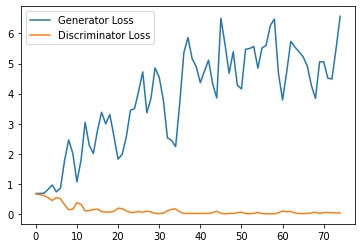

Step 2000: Generator loss: 4.05433916759491, discriminator loss: 0.08901972132362425


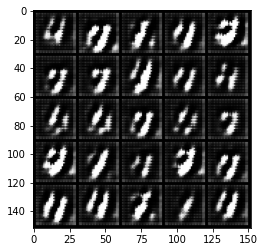

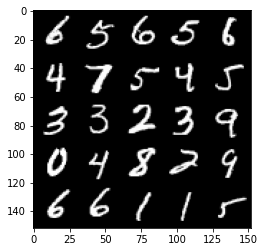

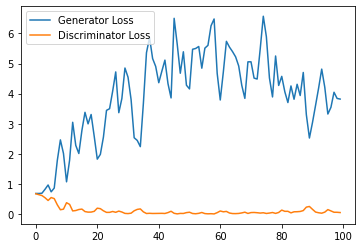

Step 2500: Generator loss: 3.730923578262329, discriminator loss: 0.10973714379221201


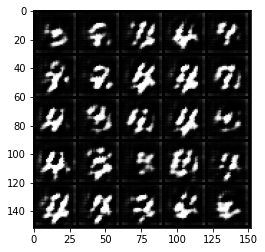

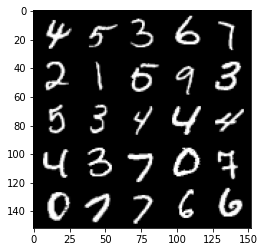

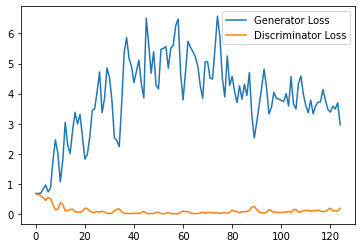

Step 3000: Generator loss: 2.784380834579468, discriminator loss: 0.207772427752614


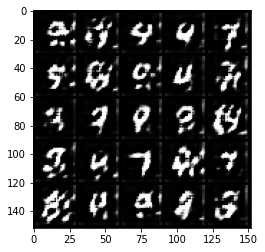

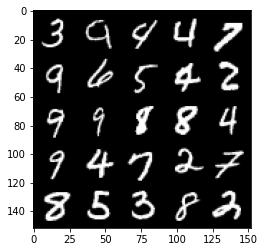

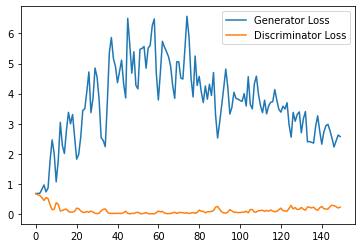

Step 3500: Generator loss: 2.3303506729602814, discriminator loss: 0.32852404499053955


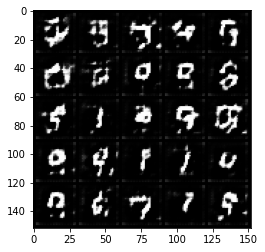

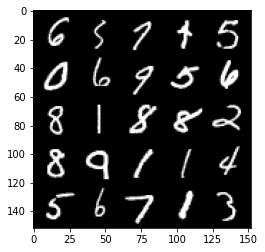

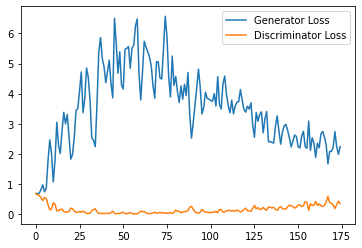

Step 4000: Generator loss: 2.055909823656082, discriminator loss: 0.3226179112493992


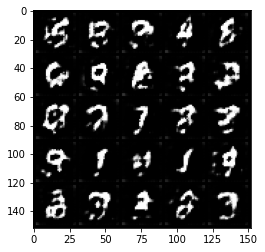

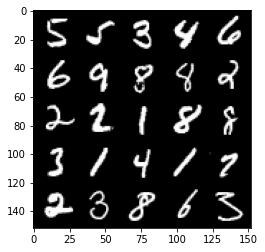

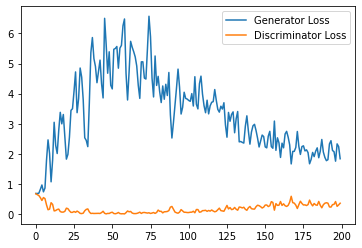

Step 4500: Generator loss: 2.0249727714061736, discriminator loss: 0.3376535064280033


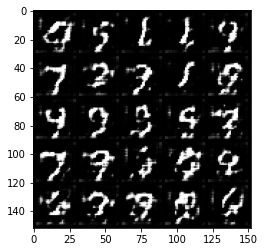

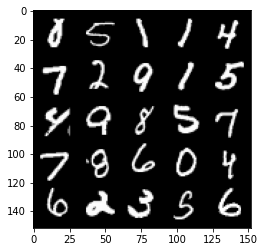

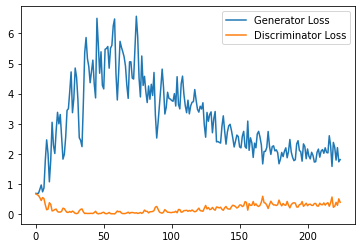

Step 5000: Generator loss: 1.9083767755031587, discriminator loss: 0.3396796433031559


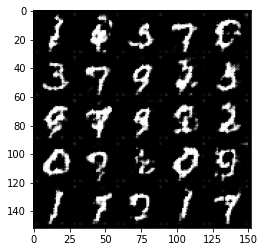

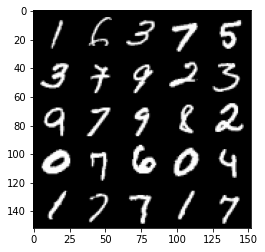

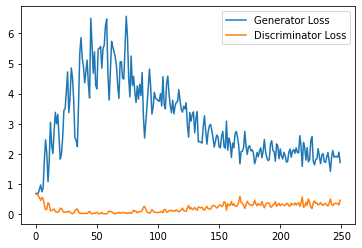

Step 5500: Generator loss: 2.096581702709198, discriminator loss: 0.3424498929679394


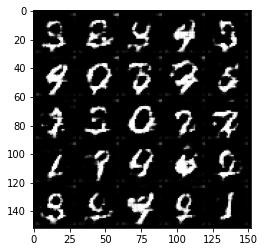

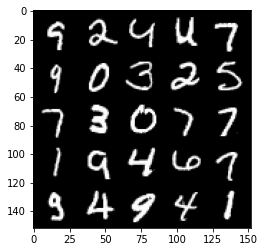

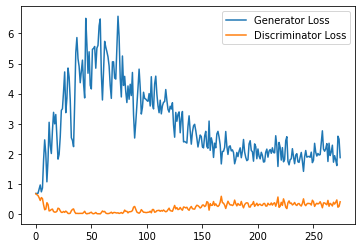

Step 6000: Generator loss: 1.7836964766979218, discriminator loss: 0.37055553352832793


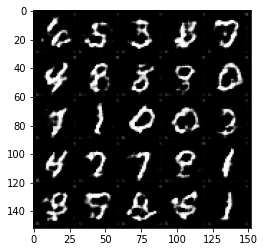

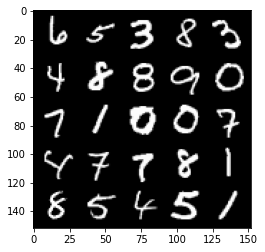

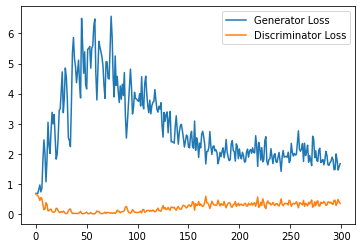

Step 6500: Generator loss: 1.7390072109699248, discriminator loss: 0.3787602734863758


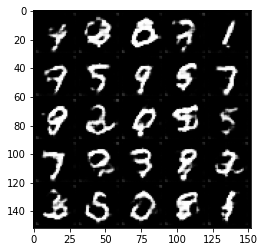

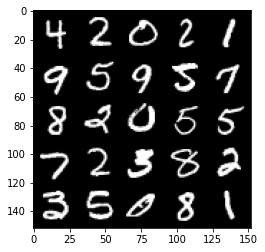

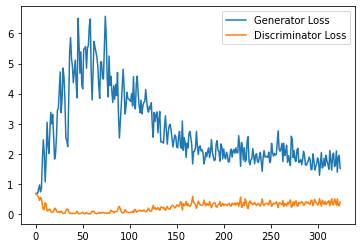

Step 7000: Generator loss: 1.657991729736328, discriminator loss: 0.3956317022740841


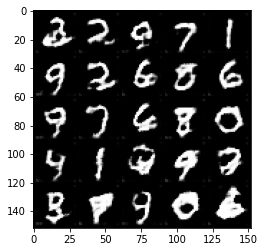

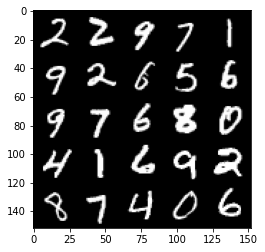

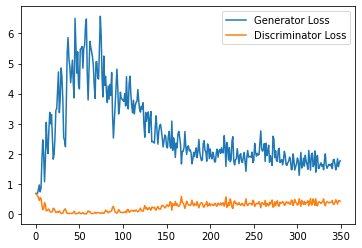

Step 7500: Generator loss: 1.617793420433998, discriminator loss: 0.4123092865347862


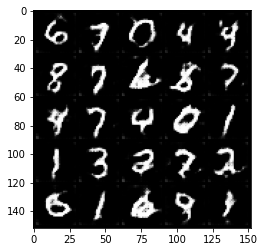

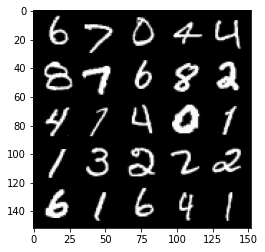

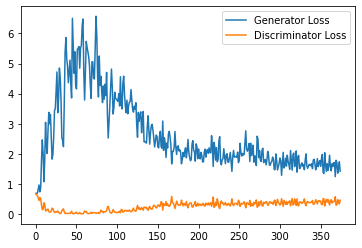

Step 8000: Generator loss: 1.6595997933149338, discriminator loss: 0.41795285141468047


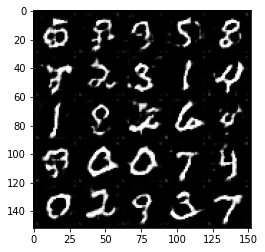

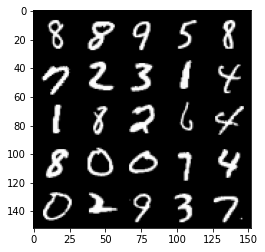

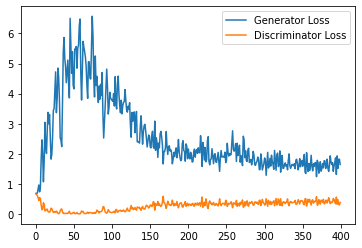

Step 8500: Generator loss: 1.5736974148750305, discriminator loss: 0.4505064491033554


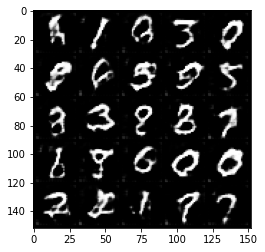

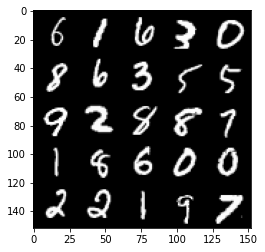

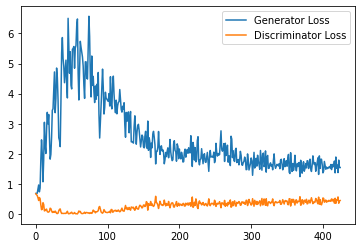

Step 9000: Generator loss: 1.4652267844676972, discriminator loss: 0.4540128076076508


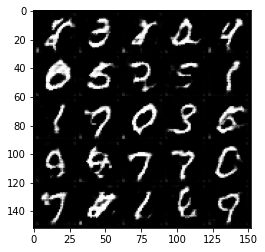

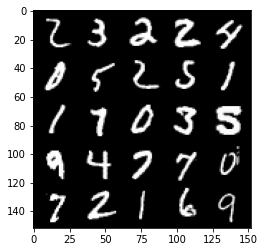

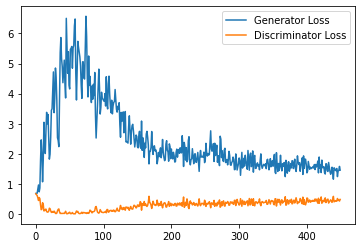

Step 9500: Generator loss: 1.4445271117687226, discriminator loss: 0.46373515427112577


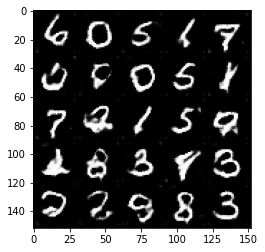

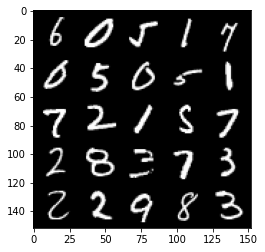

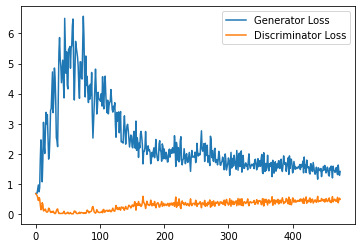

Step 10000: Generator loss: 1.4703339346647262, discriminator loss: 0.4819010688662529


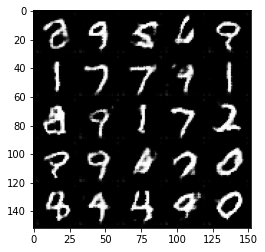

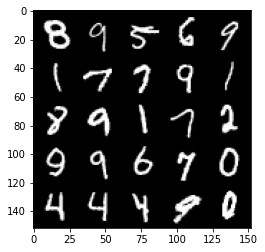

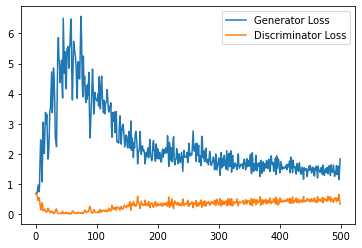

Step 10500: Generator loss: 1.3672590748071671, discriminator loss: 0.5040576613545418


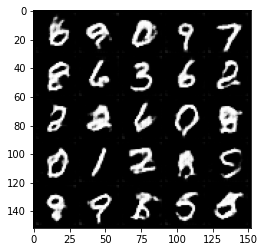

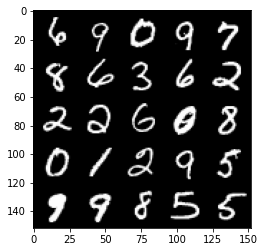

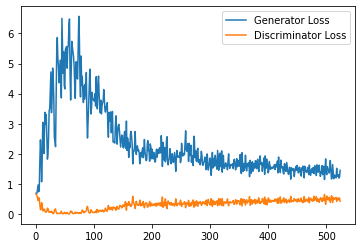

Step 11000: Generator loss: 1.3402953808307647, discriminator loss: 0.5090512815117836


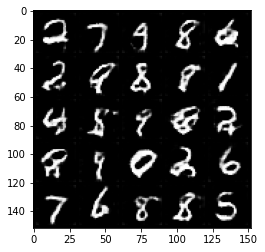

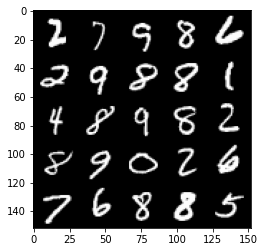

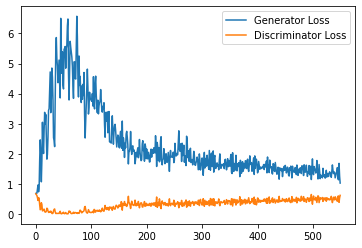

Step 11500: Generator loss: 1.3163475192785263, discriminator loss: 0.5176828497648239


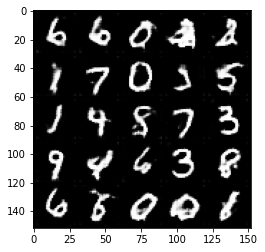

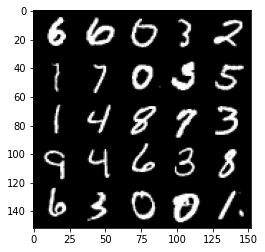

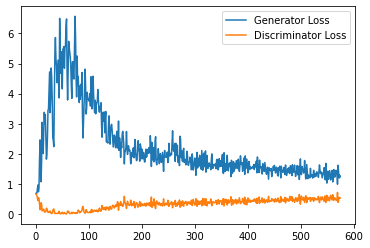

Step 12000: Generator loss: 1.27794510948658, discriminator loss: 0.517574915587902


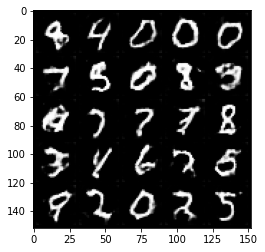

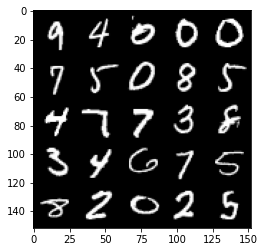

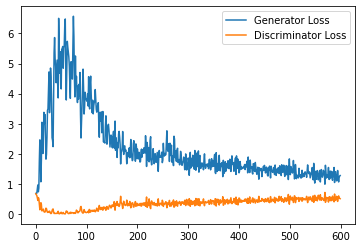

Step 12500: Generator loss: 1.232251323580742, discriminator loss: 0.5304298322796822


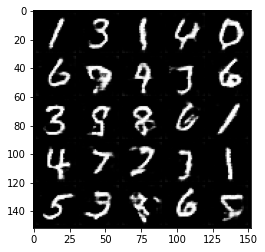

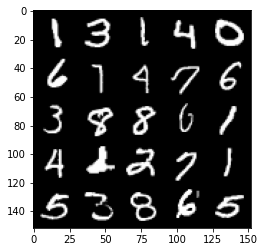

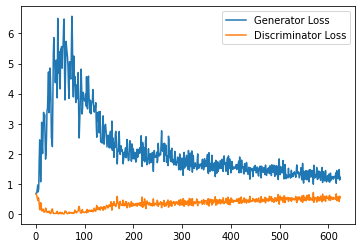

Step 13000: Generator loss: 1.2557285879850388, discriminator loss: 0.5302457603812217


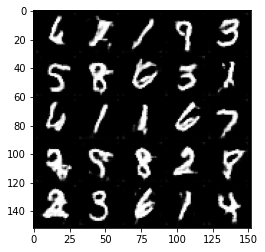

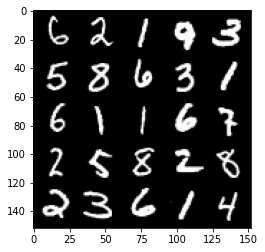

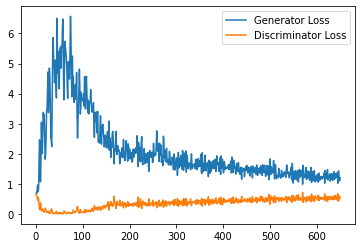

Step 13500: Generator loss: 1.2280162674188615, discriminator loss: 0.5378388435840606


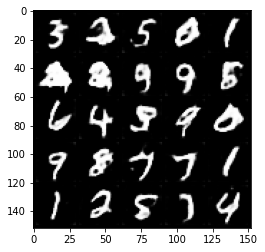

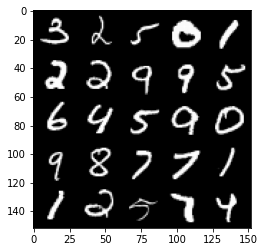

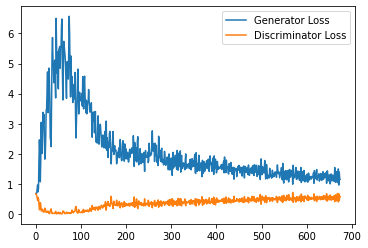

Step 14000: Generator loss: 1.2026727126836776, discriminator loss: 0.5419554495811463


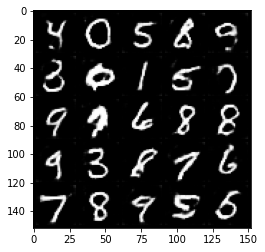

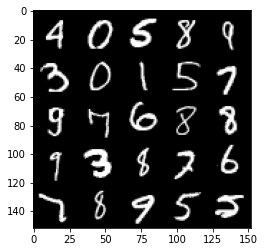

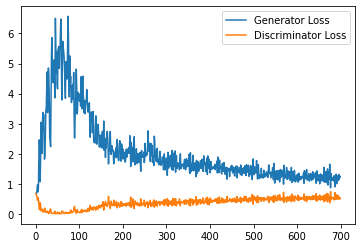

Step 14500: Generator loss: 1.2085174748897551, discriminator loss: 0.5507763485908508


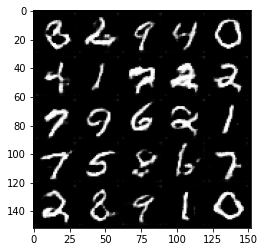

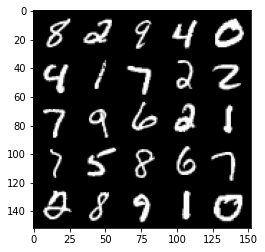

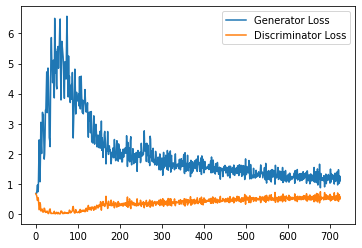

Step 15000: Generator loss: 1.1635735164880752, discriminator loss: 0.5520580558180809


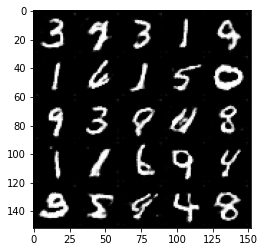

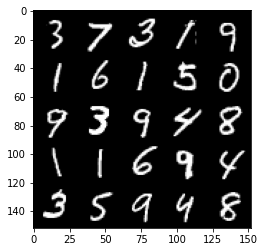

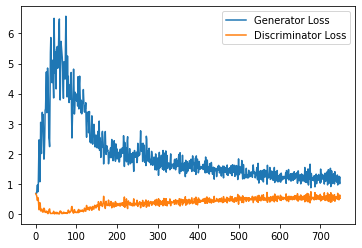

Step 15500: Generator loss: 1.1647037255764008, discriminator loss: 0.5526675367355347


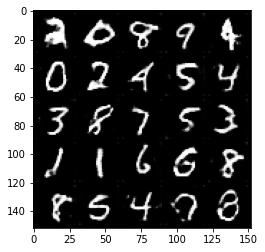

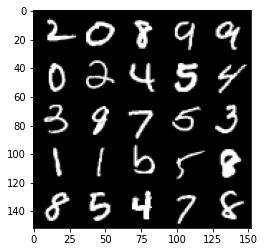

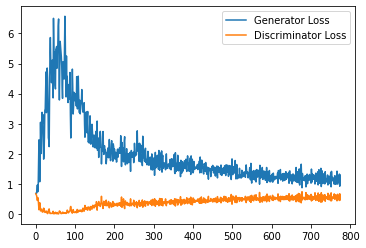

Step 16000: Generator loss: 1.1300369437932969, discriminator loss: 0.5569328840970993


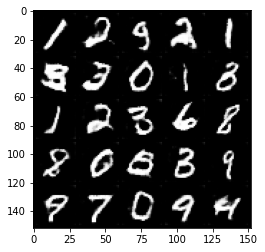

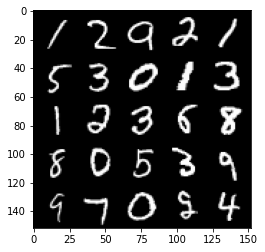

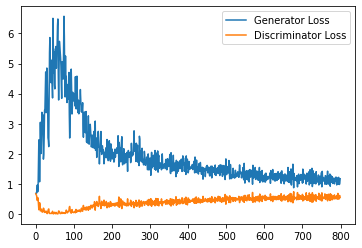

Step 16500: Generator loss: 1.1758686950206756, discriminator loss: 0.5559596553444862


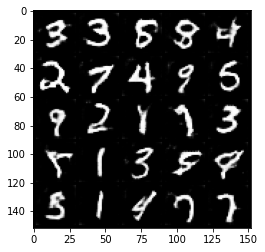

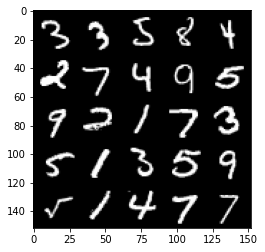

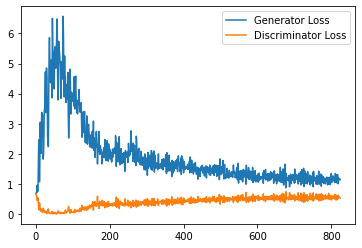

Step 17000: Generator loss: 1.1400459809303283, discriminator loss: 0.5589472181200981


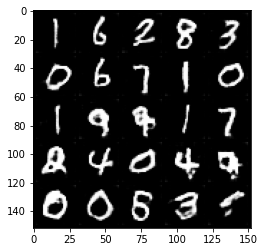

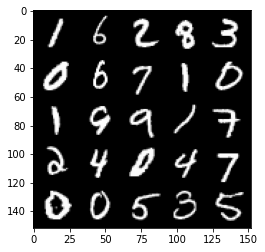

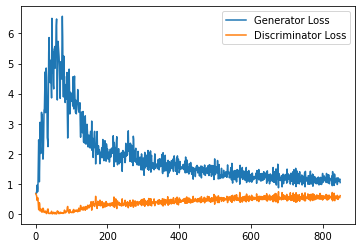

Step 17500: Generator loss: 1.1565908391475677, discriminator loss: 0.5666934060454368


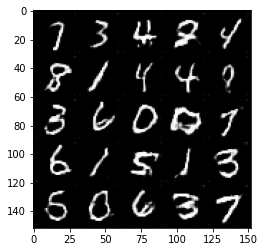

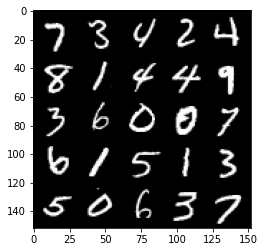

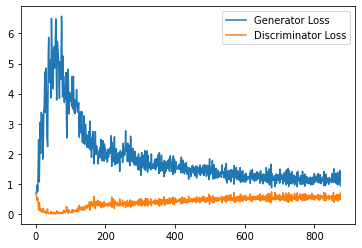

Step 18000: Generator loss: 1.1729338818788528, discriminator loss: 0.5628947925567627


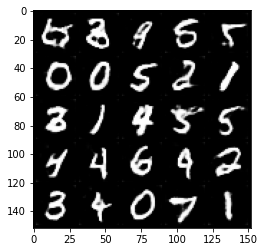

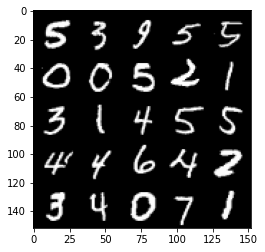

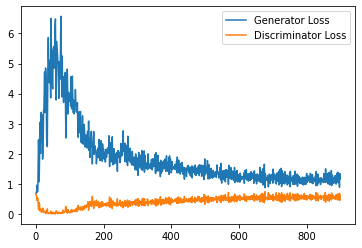

Step 18500: Generator loss: 1.1399594283103942, discriminator loss: 0.5612072744965553


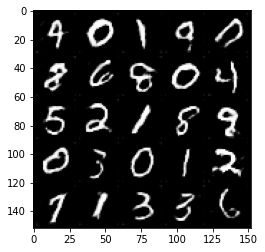

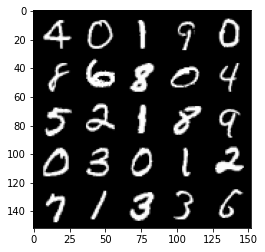

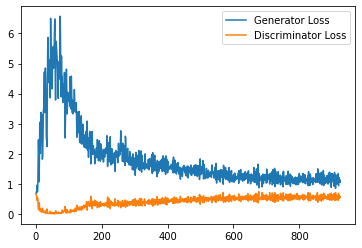

Step 19000: Generator loss: 1.1327349507808686, discriminator loss: 0.566722621679306


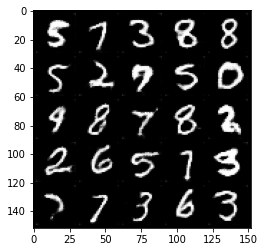

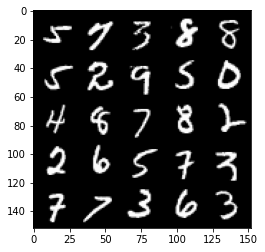

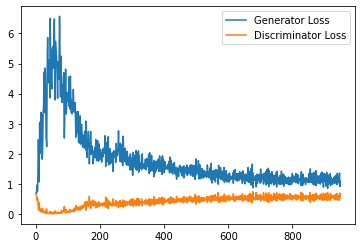

Step 19500: Generator loss: 1.1004164072275162, discriminator loss: 0.5687147737145424


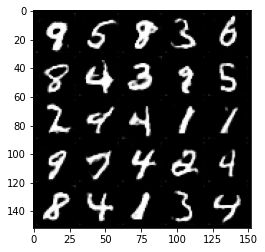

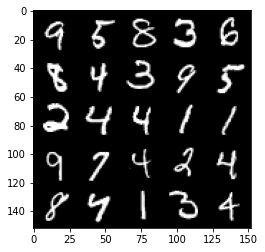

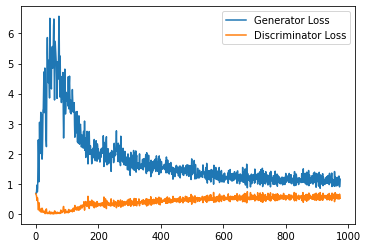

Step 20000: Generator loss: 1.1210105146169662, discriminator loss: 0.5702616467475891


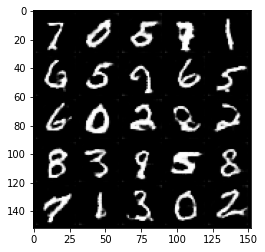

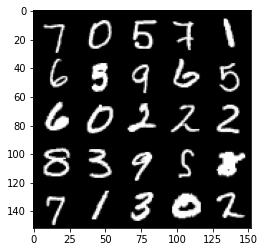

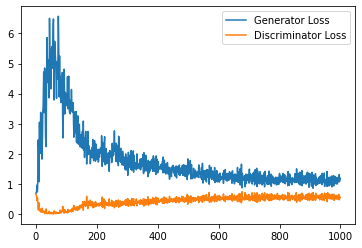

Step 20500: Generator loss: 1.1135142904520035, discriminator loss: 0.5759923839569092


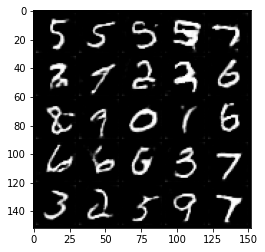

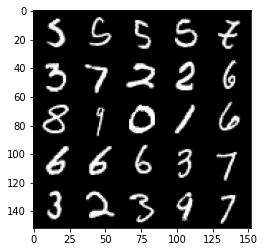

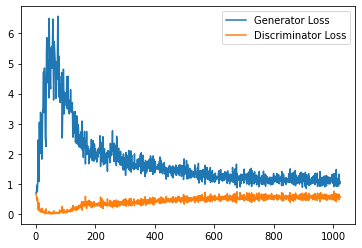

Step 21000: Generator loss: 1.0850557894706727, discriminator loss: 0.5721489784121513


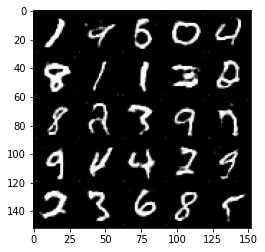

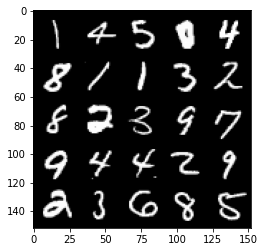

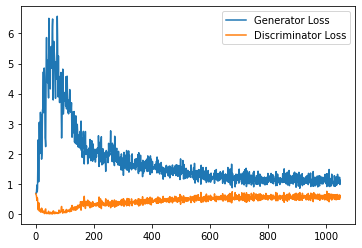

Step 21500: Generator loss: 1.0920333808660507, discriminator loss: 0.5735272934436798


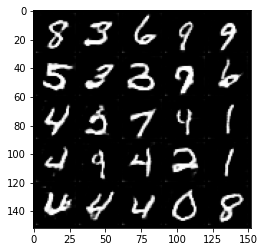

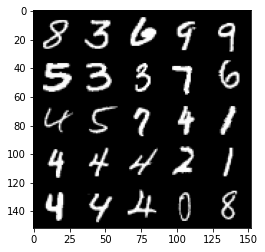

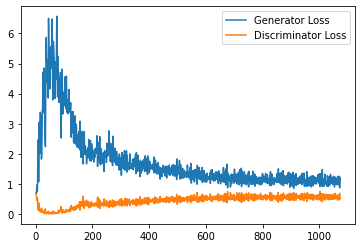

Step 22000: Generator loss: 1.0835115945339202, discriminator loss: 0.5778217015266418


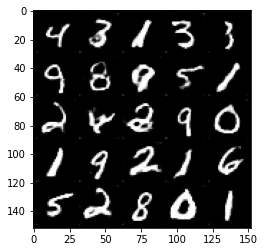

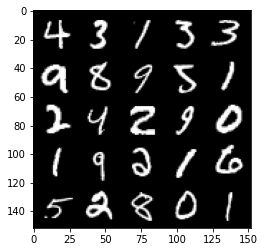

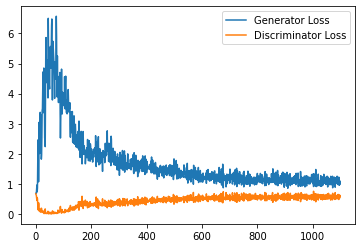

Step 22500: Generator loss: 1.0948758212327958, discriminator loss: 0.577969099521637


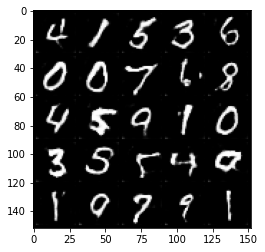

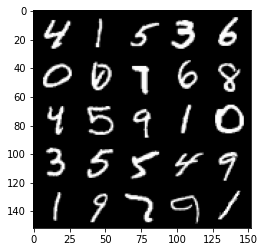

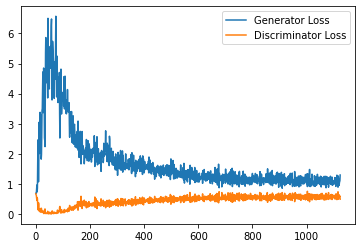

Step 23000: Generator loss: 1.0932100048065185, discriminator loss: 0.5785923320055008


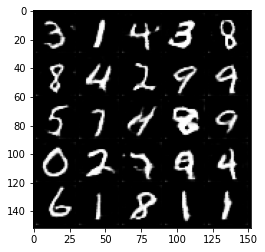

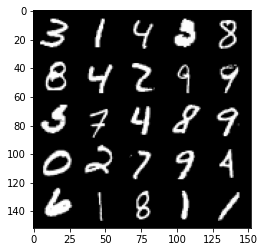

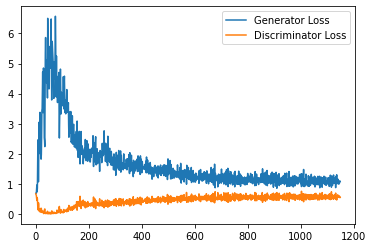

Step 23500: Generator loss: 1.074190339446068, discriminator loss: 0.581559966981411


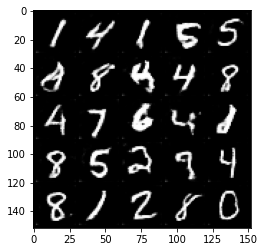

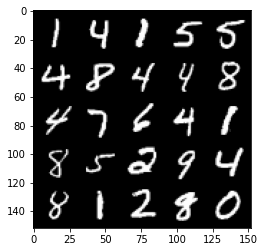

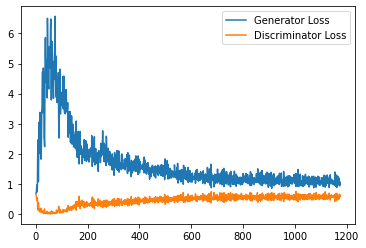

Step 24000: Generator loss: 1.049725593328476, discriminator loss: 0.580302096426487


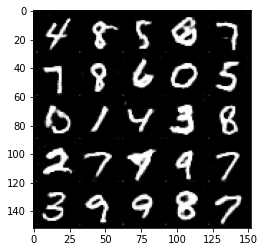

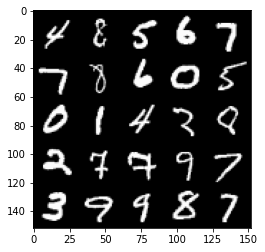

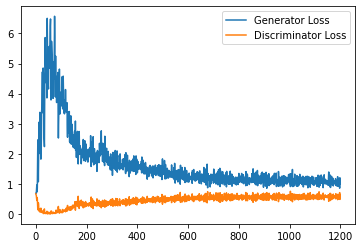

Step 24500: Generator loss: 1.0409246670007706, discriminator loss: 0.5849177197217942


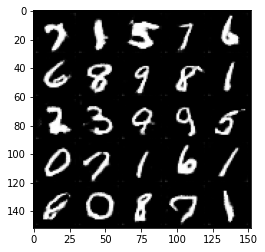

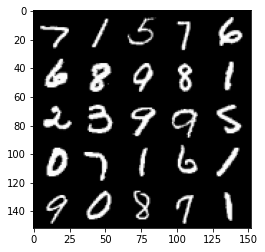

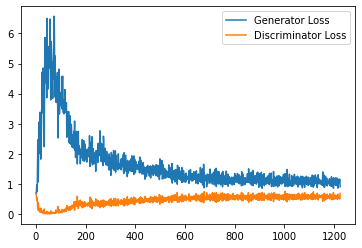

Step 25000: Generator loss: 1.0758092292547226, discriminator loss: 0.5781020056009293


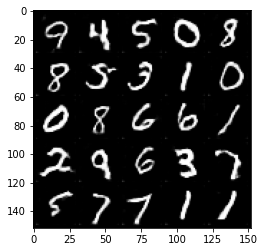

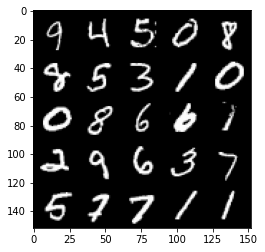

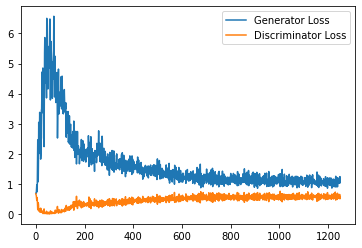

Step 25500: Generator loss: 1.0403931993246078, discriminator loss: 0.5842977243661881


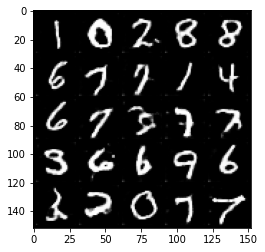

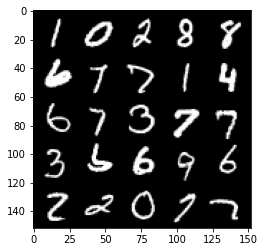

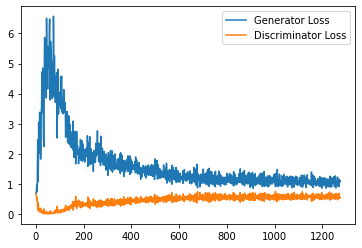

Step 26000: Generator loss: 1.0431284713745117, discriminator loss: 0.5871352153420448


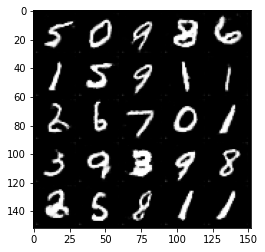

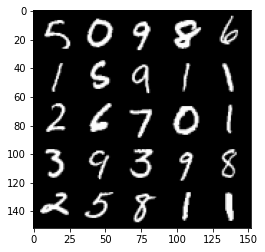

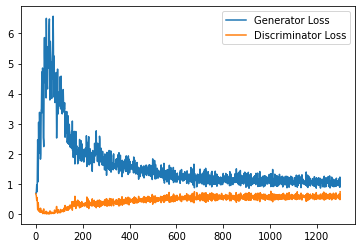

Step 26500: Generator loss: 1.0758251278400421, discriminator loss: 0.5810707240700722


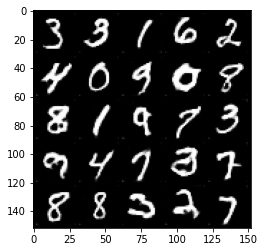

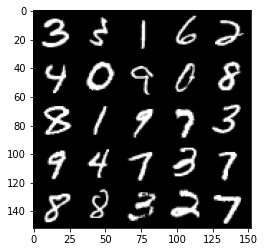

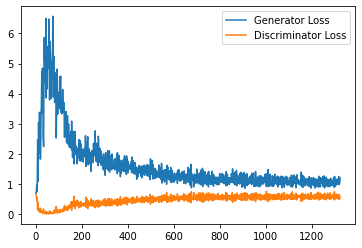

Step 27000: Generator loss: 1.043159941315651, discriminator loss: 0.5878371884226798


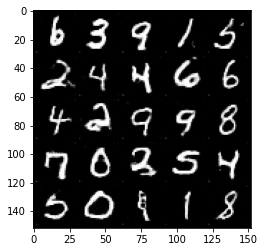

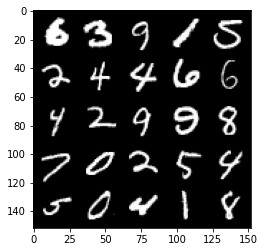

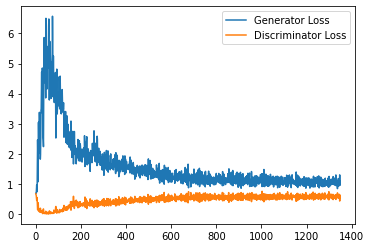

Step 27500: Generator loss: 1.0382934905290604, discriminator loss: 0.5912499698400497


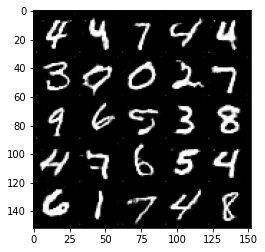

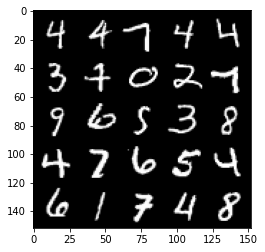

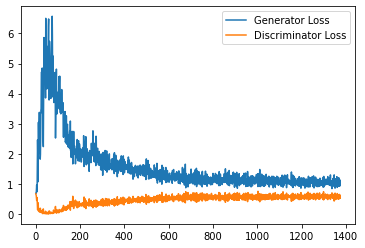

Step 28000: Generator loss: 1.0340335375070573, discriminator loss: 0.5901224370598793


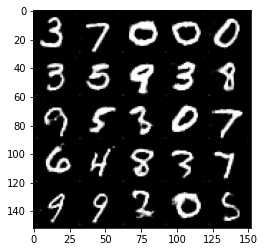

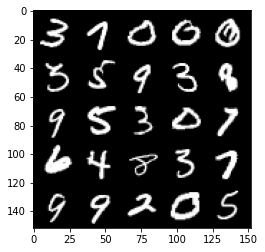

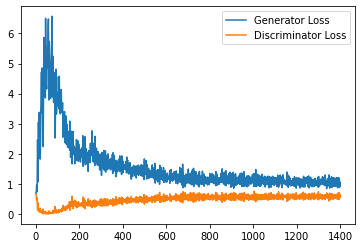

Step 28500: Generator loss: 1.032288071155548, discriminator loss: 0.586117544233799


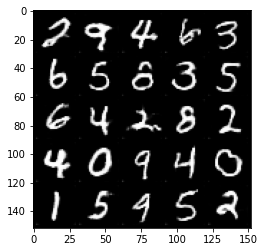

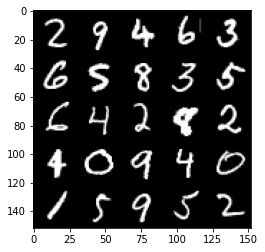

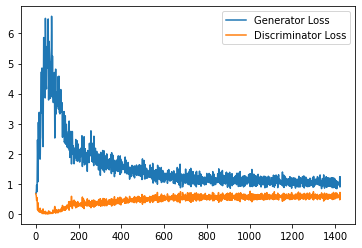

Step 29000: Generator loss: 1.0688751097917557, discriminator loss: 0.5870647776722908


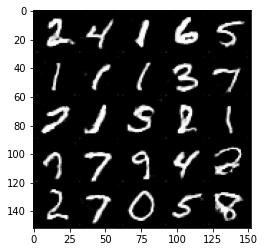

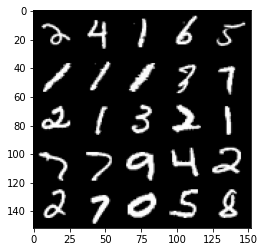

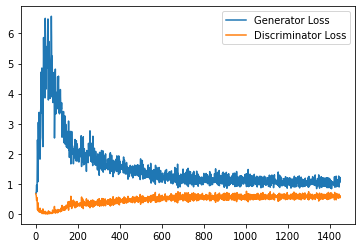

Step 29500: Generator loss: 1.0205201172828675, discriminator loss: 0.5911056190729141


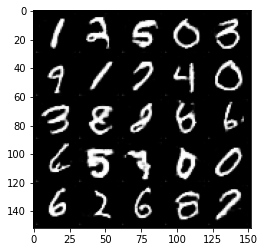

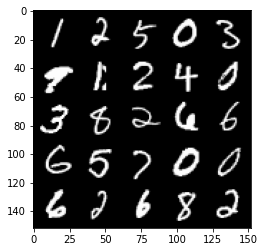

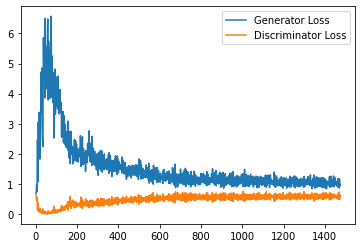

Step 30000: Generator loss: 1.0143031188249587, discriminator loss: 0.5887180142998696


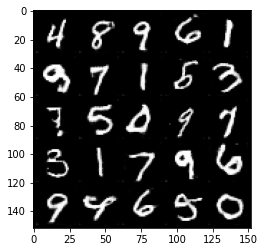

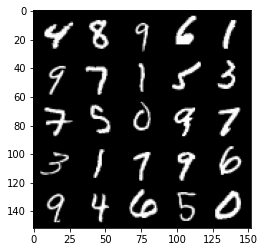

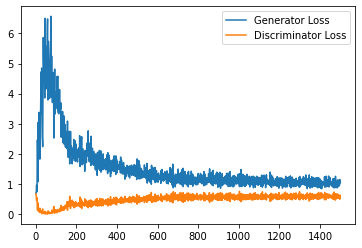

Step 30500: Generator loss: 1.0222816251516342, discriminator loss: 0.5894230234026909


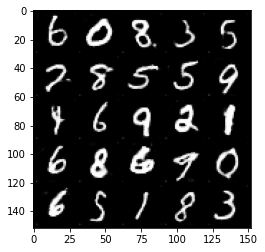

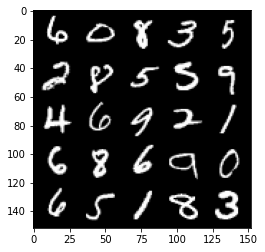

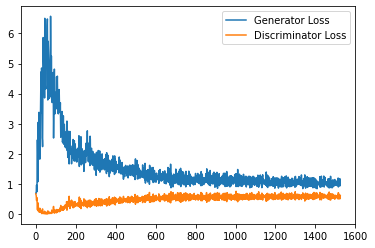

Step 31000: Generator loss: 1.0193692696094514, discriminator loss: 0.5900020876526832


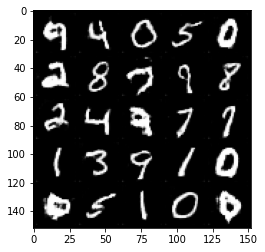

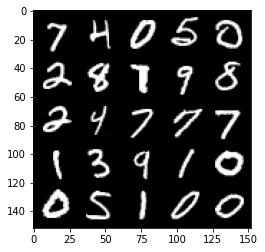

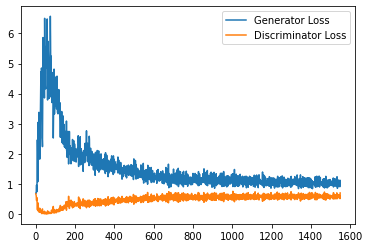

Step 31500: Generator loss: 1.0529882274866105, discriminator loss: 0.5805130588412285


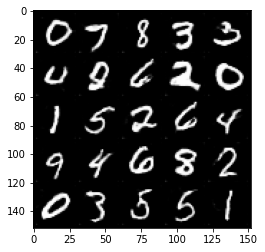

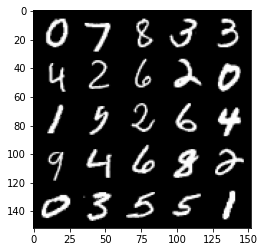

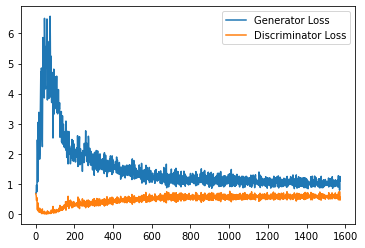

Step 32000: Generator loss: 1.0409725949764252, discriminator loss: 0.589082295179367


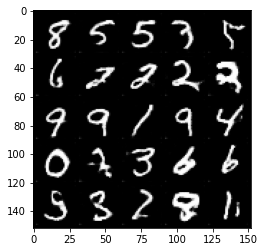

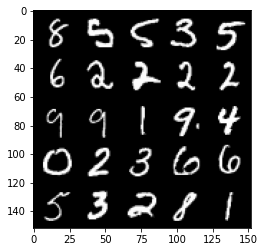

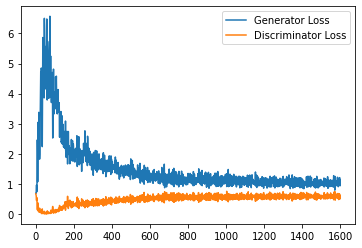

Step 32500: Generator loss: 1.0428663966655731, discriminator loss: 0.5856469511389732


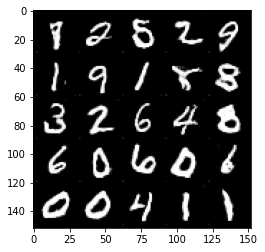

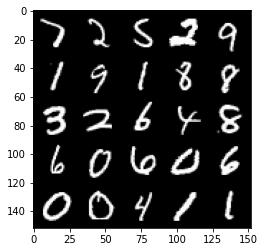

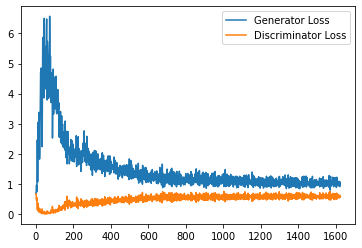

Step 33000: Generator loss: 1.0378449680805206, discriminator loss: 0.581645939707756


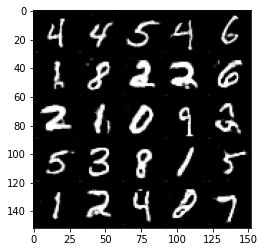

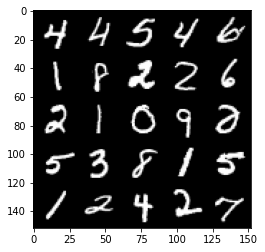

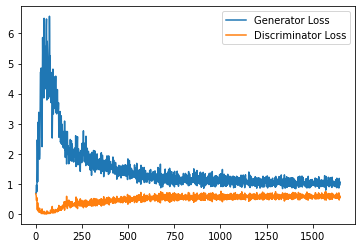

Step 33500: Generator loss: 1.0295006181001662, discriminator loss: 0.5877357315421105


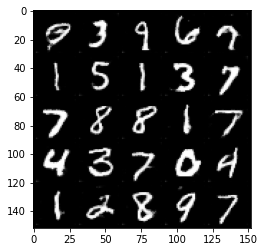

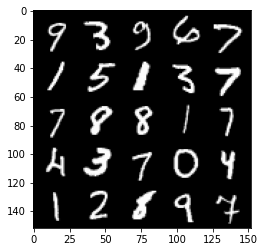

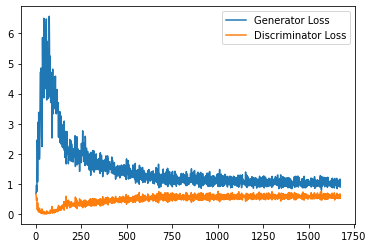

Step 34000: Generator loss: 1.0512508134841918, discriminator loss: 0.5864788472652436


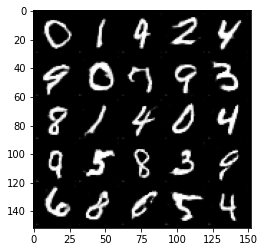

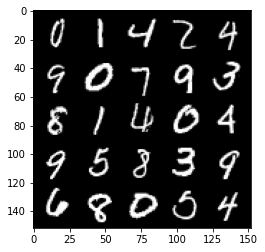

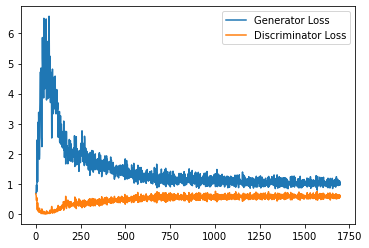

Step 34500: Generator loss: 1.0287851454019548, discriminator loss: 0.5893754813075066


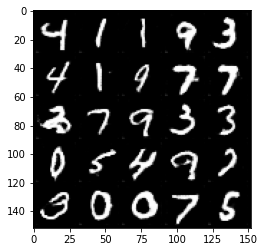

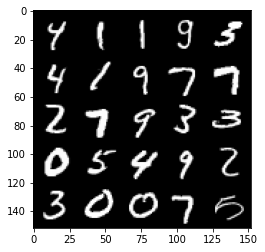

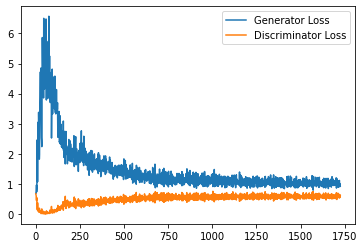

Step 35000: Generator loss: 1.0239933475255967, discriminator loss: 0.5802443660497666


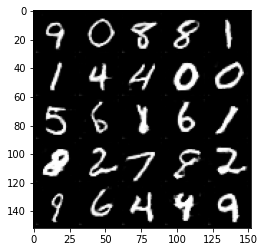

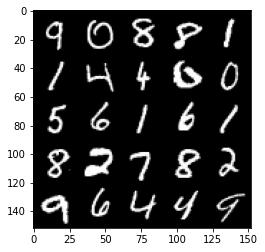

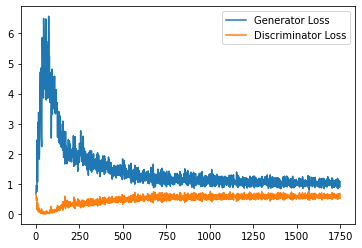

Step 35500: Generator loss: 1.012480188369751, discriminator loss: 0.5878601796030998


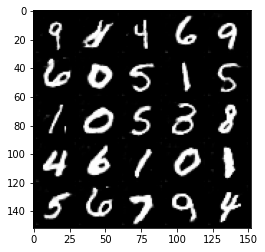

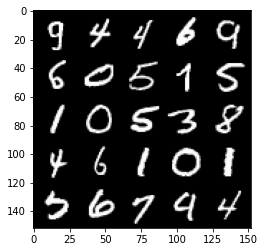

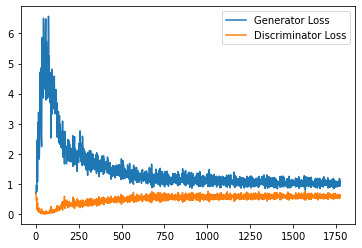

Step 36000: Generator loss: 1.0305861324071883, discriminator loss: 0.5883164602518082


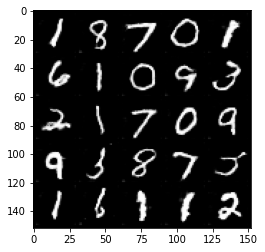

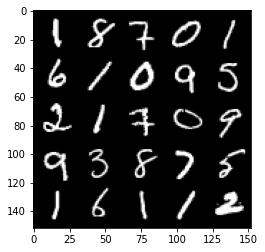

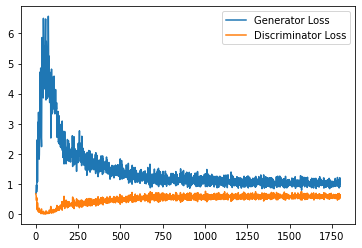

Step 36500: Generator loss: 1.0517441899776458, discriminator loss: 0.5817448329925538


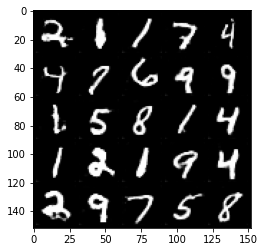

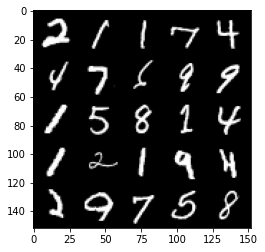

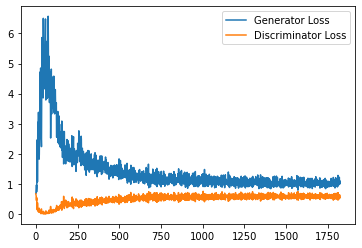

Step 37000: Generator loss: 1.0565518456697465, discriminator loss: 0.5838641539812088


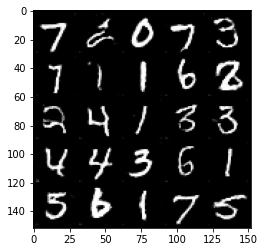

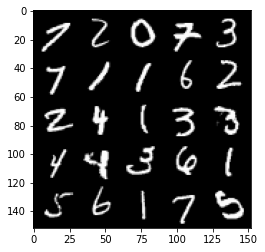

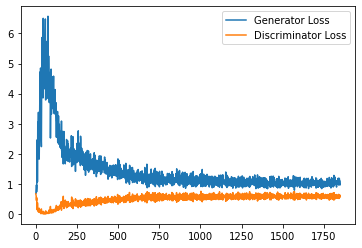

Step 37500: Generator loss: 1.048744460105896, discriminator loss: 0.5788119478225708


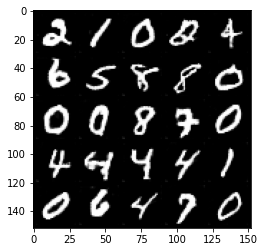

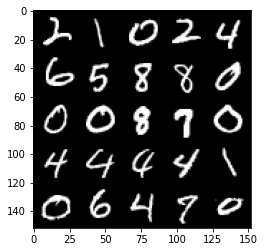

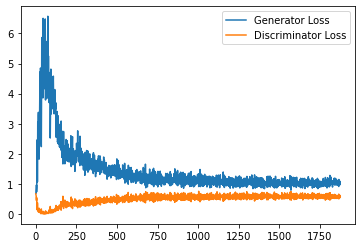

Step 38000: Generator loss: 1.0172689052820205, discriminator loss: 0.5850832250118255


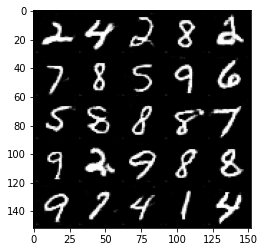

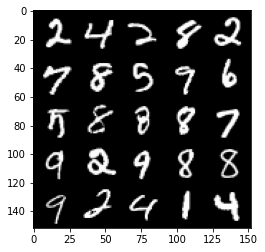

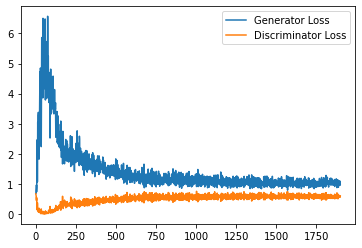

Step 38500: Generator loss: 1.0308047721385956, discriminator loss: 0.5802501515746117


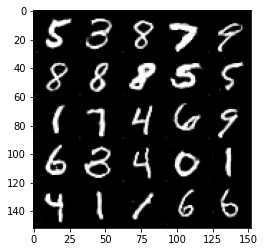

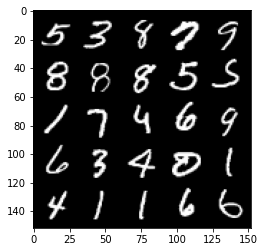

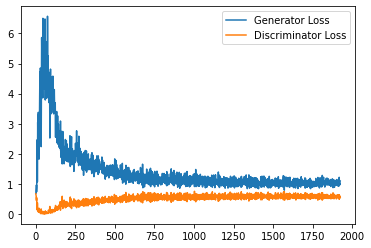

Step 39000: Generator loss: 1.0249818357229232, discriminator loss: 0.582423688352108


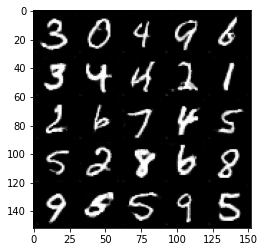

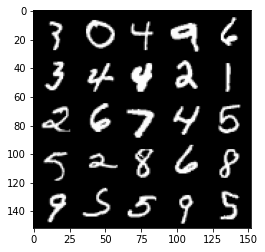

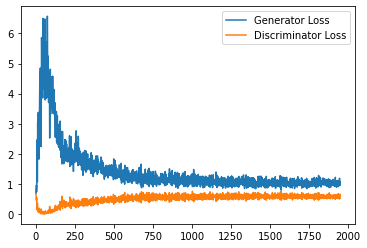

Step 39500: Generator loss: 1.059788269519806, discriminator loss: 0.5842710344195365


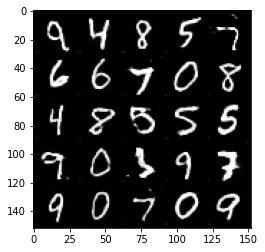

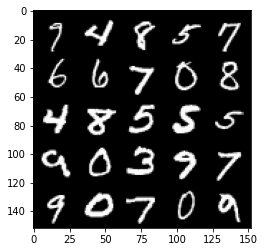

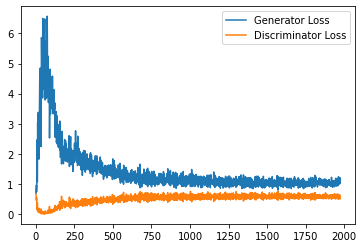

Step 40000: Generator loss: 1.0244112676382064, discriminator loss: 0.5838582642674446


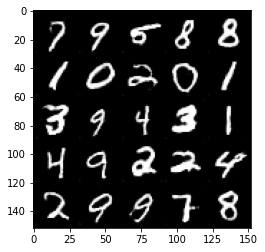

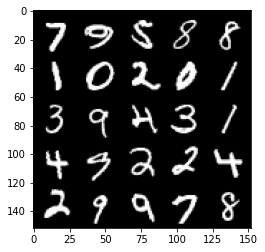

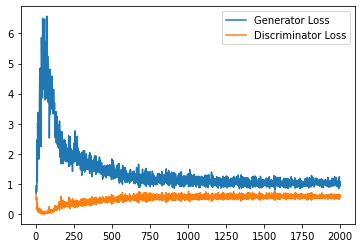

Step 40500: Generator loss: 1.0377220350503922, discriminator loss: 0.5808780723810196


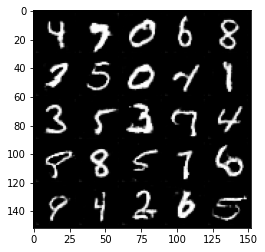

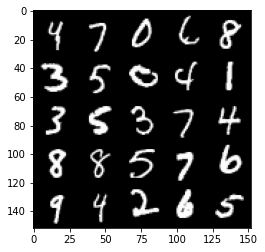

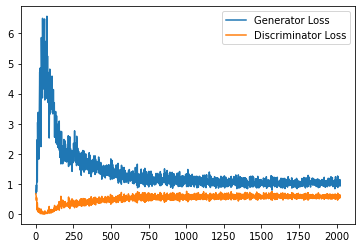

Step 41000: Generator loss: 1.0486179670095443, discriminator loss: 0.5773571093678475


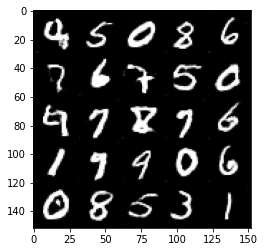

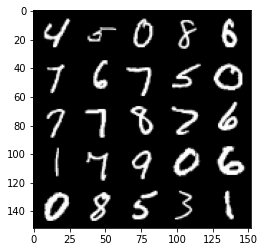

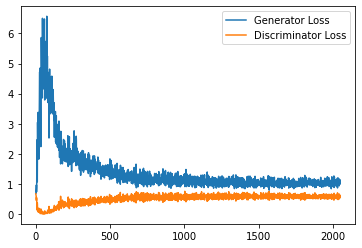

Step 41500: Generator loss: 1.0371169732809067, discriminator loss: 0.5820291261672974


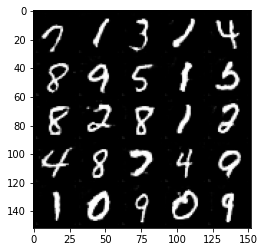

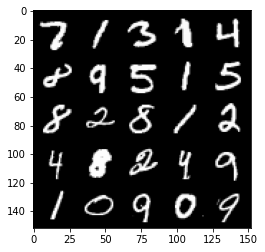

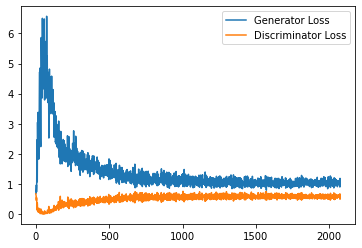

Step 42000: Generator loss: 1.0459235516786576, discriminator loss: 0.5825867295265198


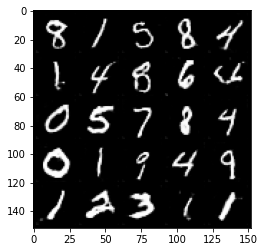

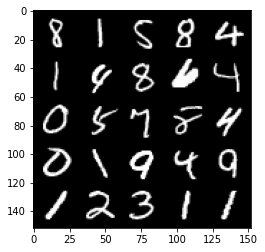

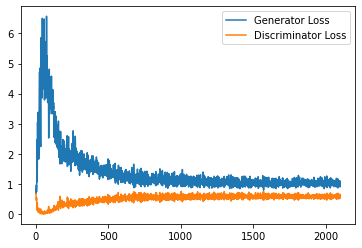

Step 42500: Generator loss: 1.0278298205137253, discriminator loss: 0.5795505378246307


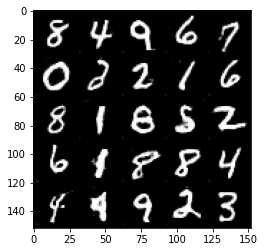

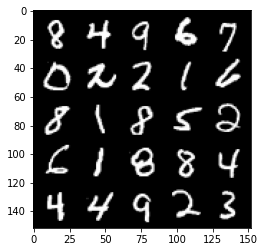

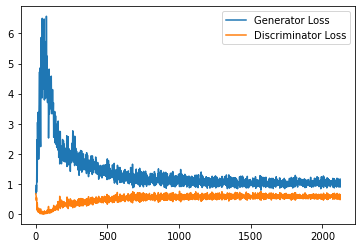

Step 43000: Generator loss: 1.036450998544693, discriminator loss: 0.579375716149807


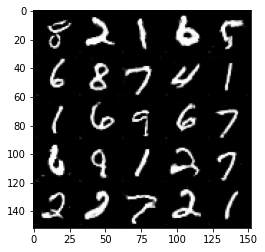

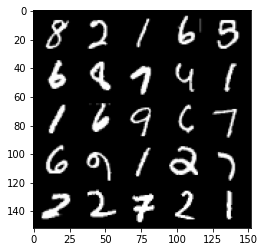

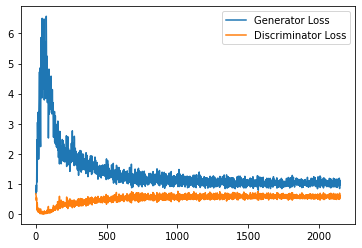

Step 43500: Generator loss: 1.0461036304235458, discriminator loss: 0.5744591353535652


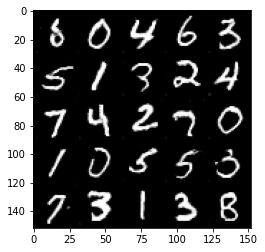

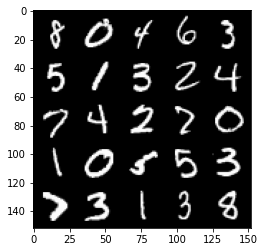

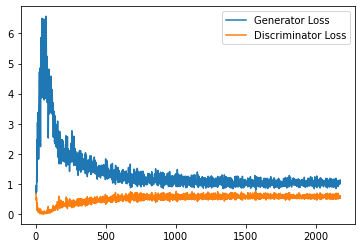

Step 44000: Generator loss: 1.0523059315681458, discriminator loss: 0.5788329694271087


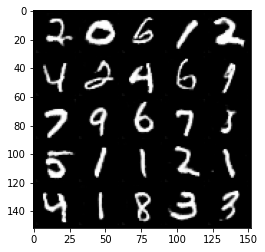

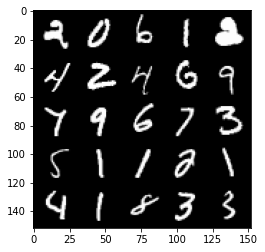

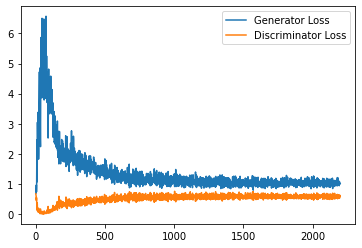

Step 44500: Generator loss: 1.0297258162498475, discriminator loss: 0.579976598739624


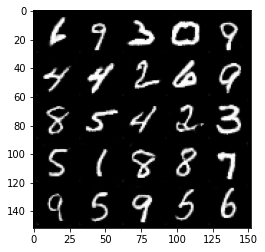

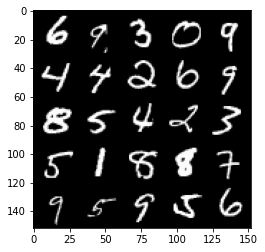

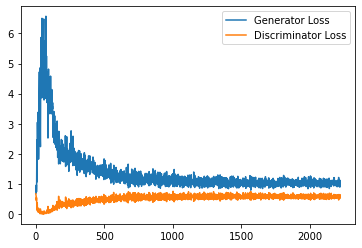

Step 45000: Generator loss: 1.0308130308389665, discriminator loss: 0.5812777386307716


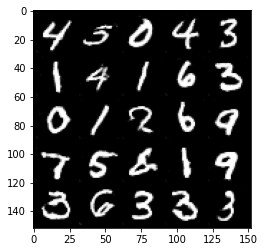

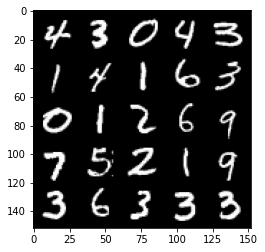

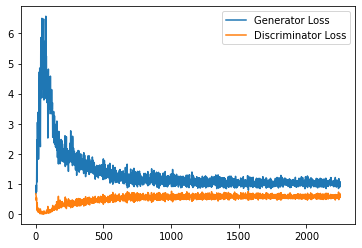

Step 45500: Generator loss: 1.026417898774147, discriminator loss: 0.5810490416288376


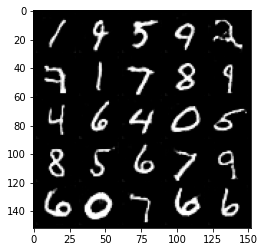

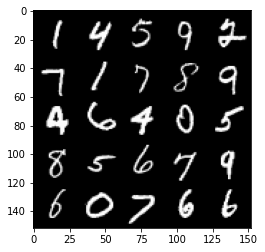

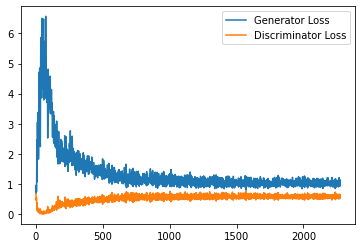

Step 46000: Generator loss: 1.0512936462163924, discriminator loss: 0.5749157701134682


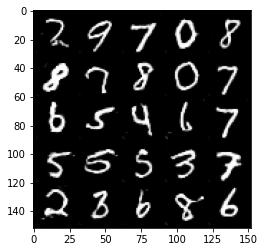

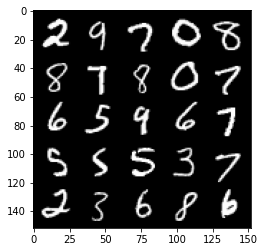

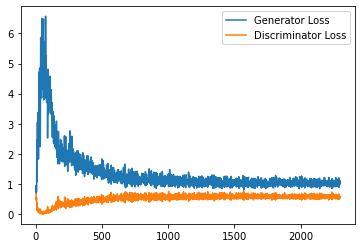

Step 46500: Generator loss: 1.046115017771721, discriminator loss: 0.5773056792020798


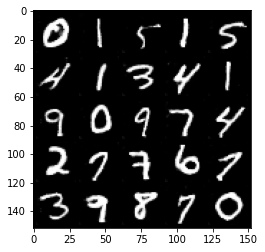

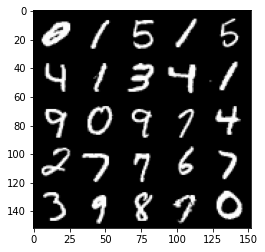

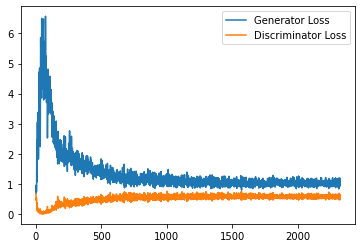

Step 47000: Generator loss: 1.0554167475700378, discriminator loss: 0.5828148840665818


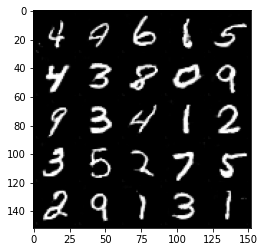

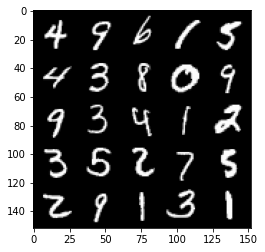

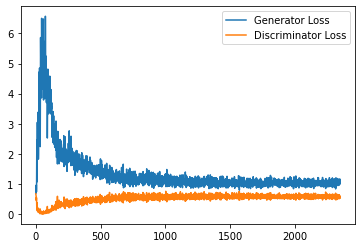

Step 47500: Generator loss: 1.0496067821979522, discriminator loss: 0.5806416366696358


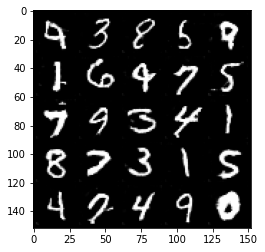

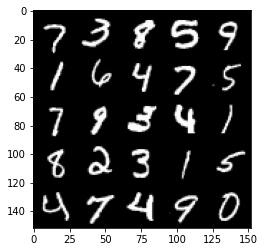

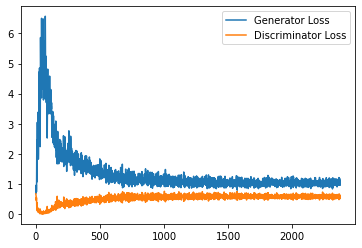

Step 48000: Generator loss: 1.0192555145025253, discriminator loss: 0.5837756601572037


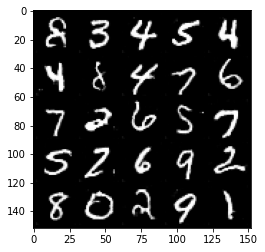

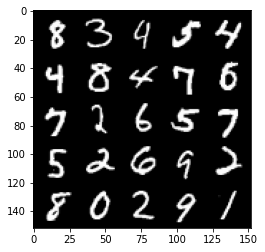

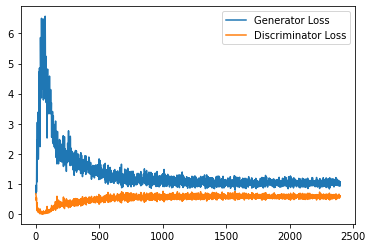

Step 48500: Generator loss: 1.0234168162345887, discriminator loss: 0.5769872477054596


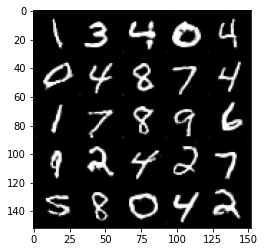

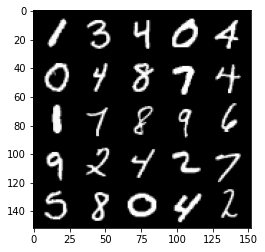

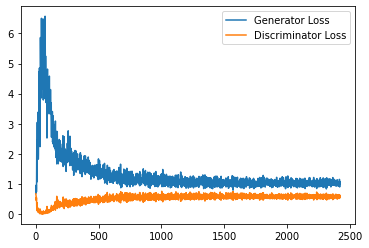

Step 49000: Generator loss: 1.0311032757759093, discriminator loss: 0.5816941616535187


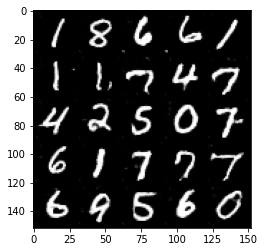

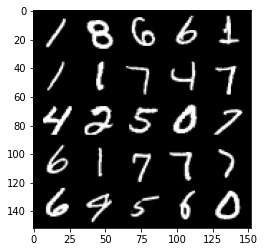

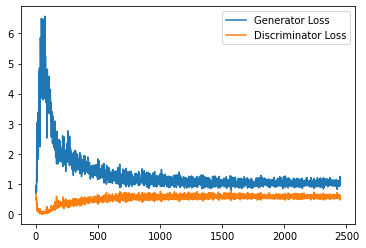

Step 49500: Generator loss: 1.04068889439106, discriminator loss: 0.580919925570488


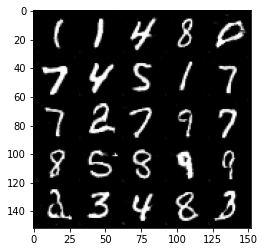

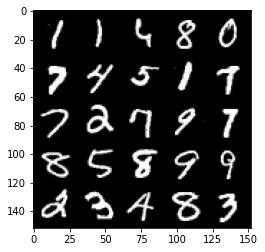

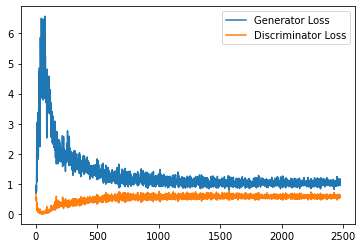

Step 50000: Generator loss: 1.0549294675588607, discriminator loss: 0.5775255293250084


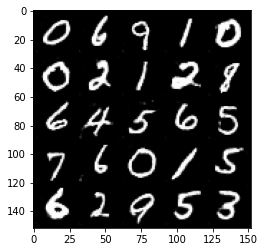

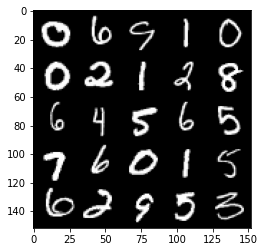

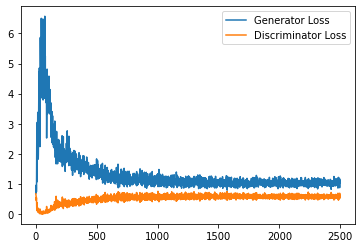

Step 50500: Generator loss: 1.0285152184963227, discriminator loss: 0.5794926013946533


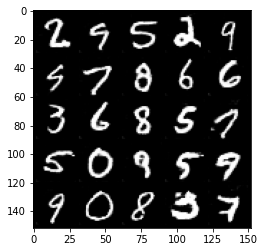

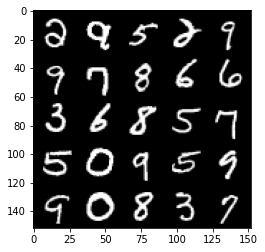

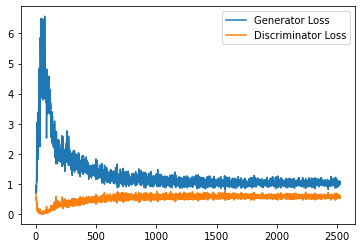

Step 51000: Generator loss: 1.0503119211196899, discriminator loss: 0.5797546645998954


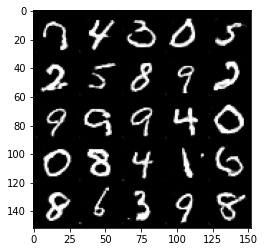

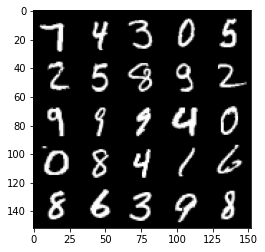

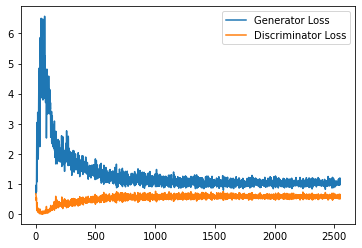

Step 51500: Generator loss: 1.0634424295425415, discriminator loss: 0.5737136691808701


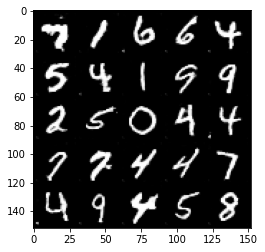

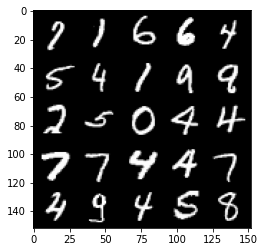

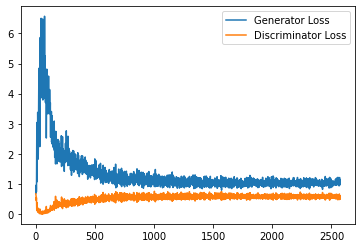

Step 52000: Generator loss: 1.0262119283676148, discriminator loss: 0.5812740602493286


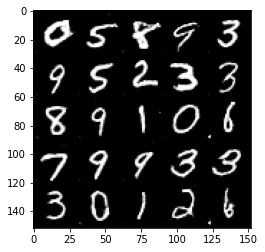

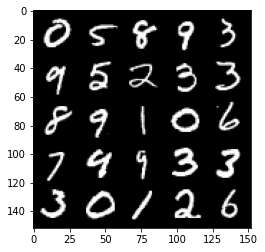

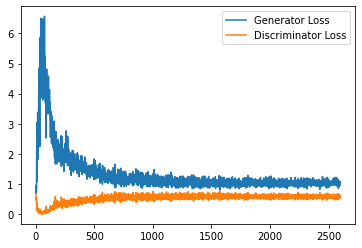

Step 52500: Generator loss: 1.0220582568645478, discriminator loss: 0.5816980403661728


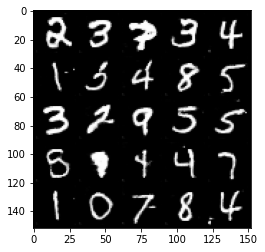

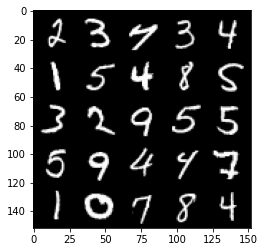

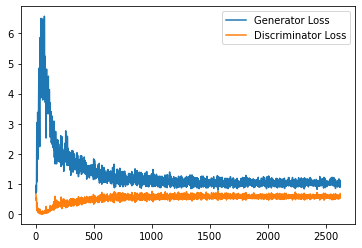

Step 53000: Generator loss: 1.0532207596302032, discriminator loss: 0.5778813245892525


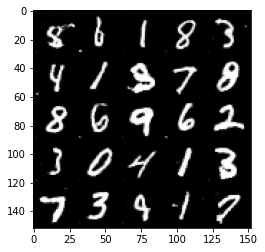

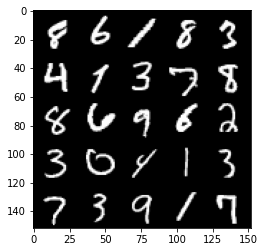

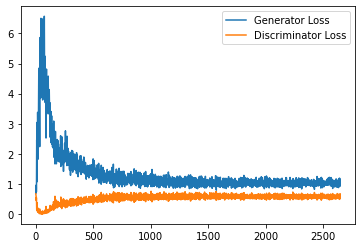

Step 53500: Generator loss: 1.053414113521576, discriminator loss: 0.5764848370552063


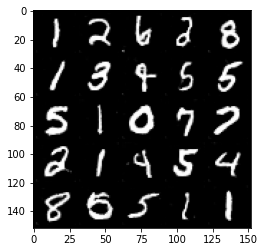

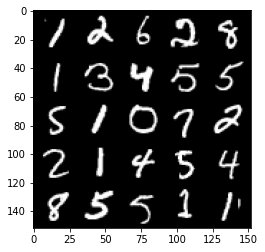

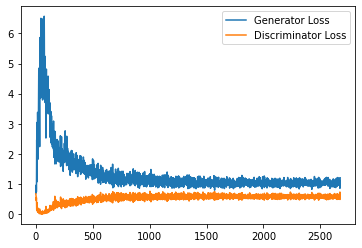

Step 54000: Generator loss: 1.047350804924965, discriminator loss: 0.5795794540047645


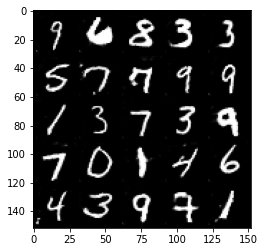

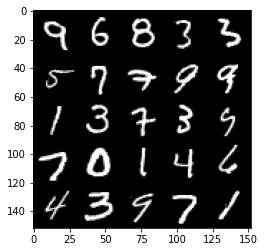

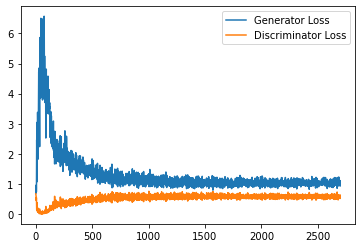

Step 54500: Generator loss: 1.0448236794471741, discriminator loss: 0.5803652923703194


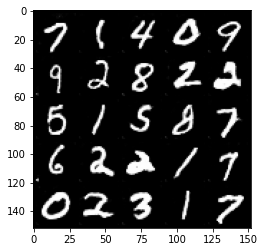

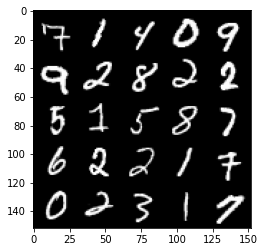

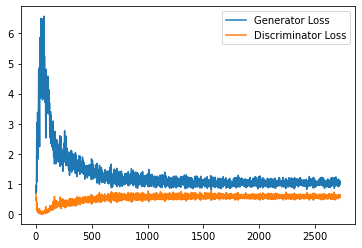

Step 55000: Generator loss: 1.036247374534607, discriminator loss: 0.5767887362241745


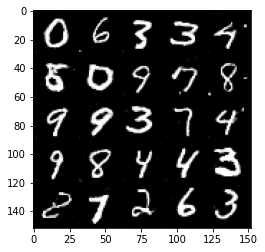

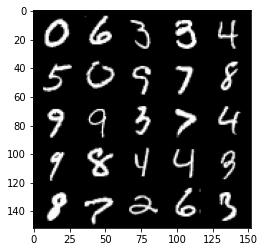

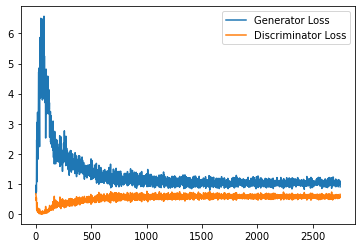

Step 55500: Generator loss: 1.0607444212436676, discriminator loss: 0.5739492917656899


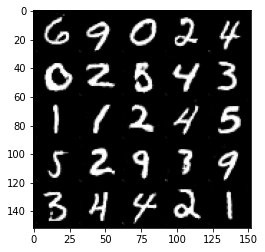

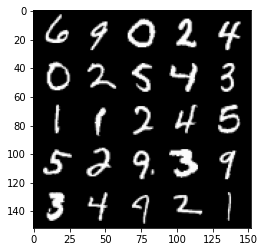

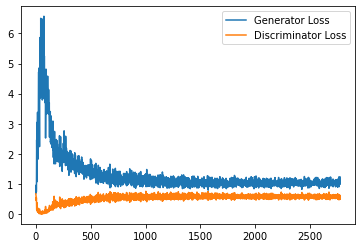

Step 56000: Generator loss: 1.0389893651008606, discriminator loss: 0.5778113175630569


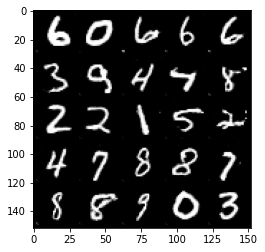

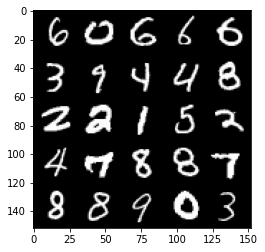

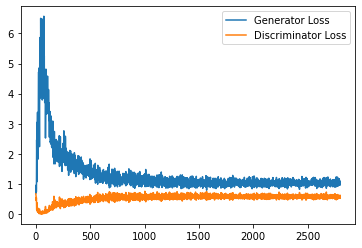

Step 56500: Generator loss: 1.0454586602449416, discriminator loss: 0.5777620304822921


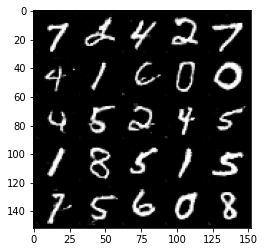

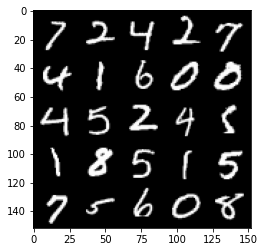

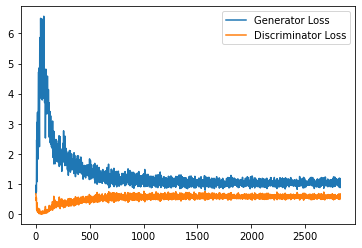

Step 57000: Generator loss: 1.0577553062438965, discriminator loss: 0.5789649307131767


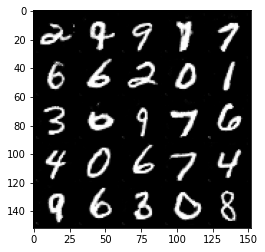

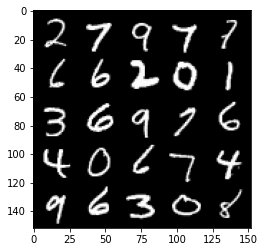

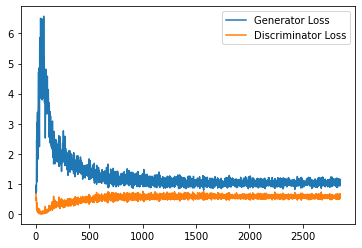

Step 57500: Generator loss: 1.0472171827554704, discriminator loss: 0.5778758231401443


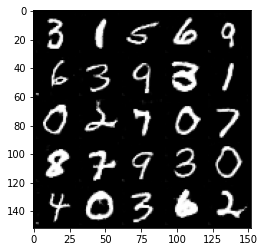

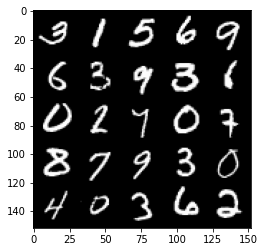

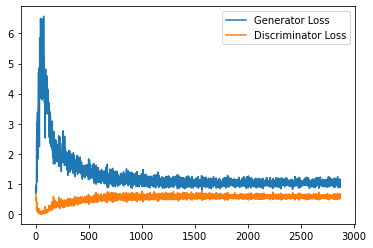

Step 58000: Generator loss: 1.0495741118192672, discriminator loss: 0.5732014301419258


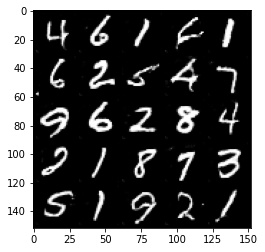

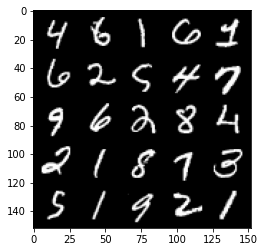

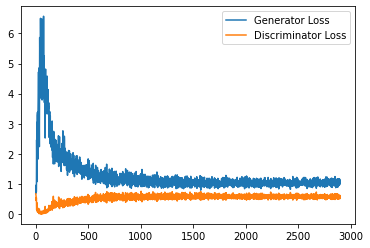

Step 58500: Generator loss: 1.0268853969573974, discriminator loss: 0.5763985063433648


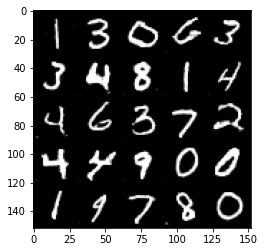

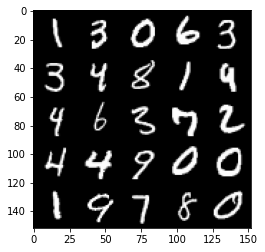

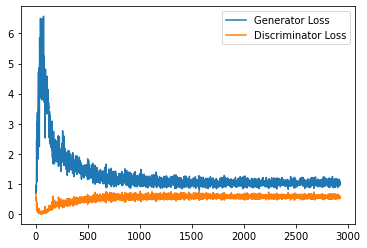

Step 59000: Generator loss: 1.0466952771544455, discriminator loss: 0.57996169090271


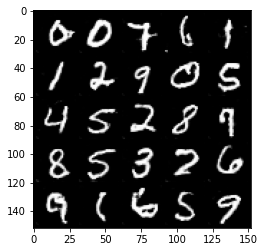

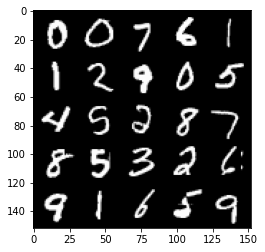

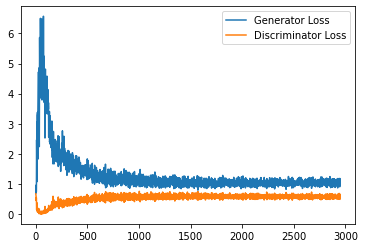

Step 59500: Generator loss: 1.0465639058351517, discriminator loss: 0.5855058023333549


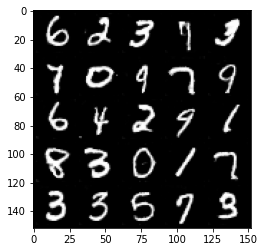

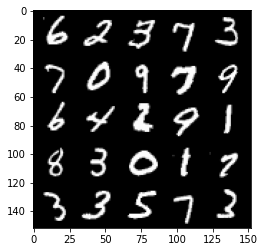

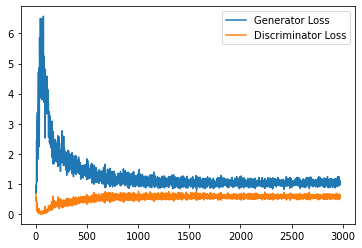

Step 60000: Generator loss: 1.0512410147190094, discriminator loss: 0.5778695085048675


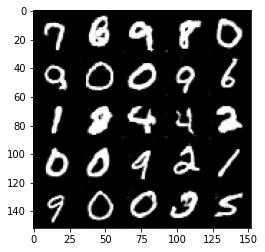

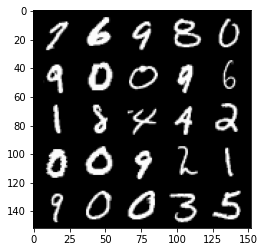

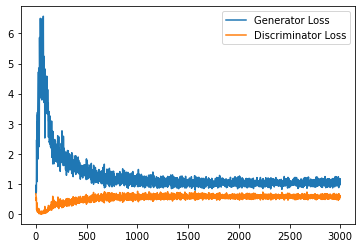

Step 60500: Generator loss: 1.0702212065458299, discriminator loss: 0.5829488173723221


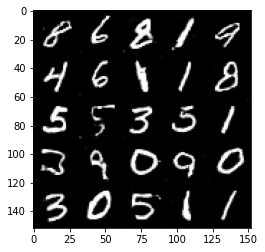

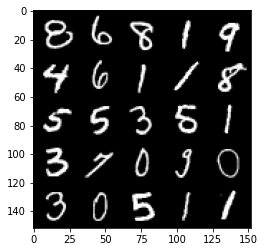

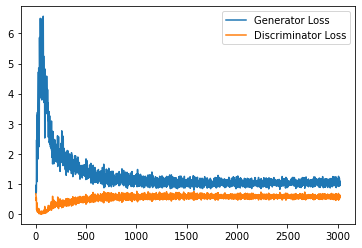

Step 61000: Generator loss: 1.0371355714797974, discriminator loss: 0.5766774690747261


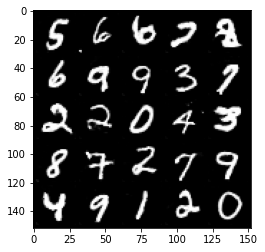

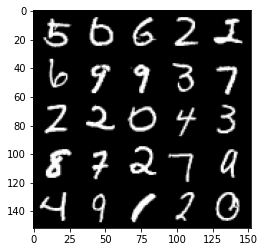

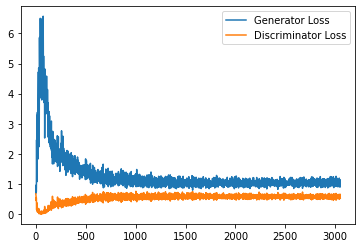

Step 61500: Generator loss: 1.0483044438362121, discriminator loss: 0.5782599726319313


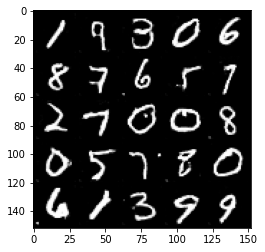

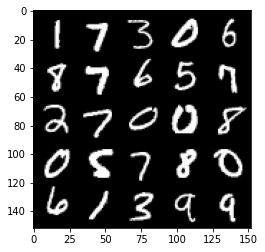

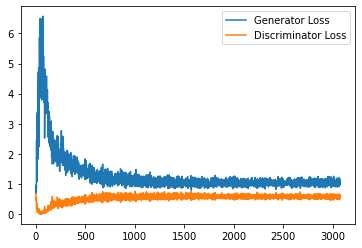

Step 62000: Generator loss: 1.029563246011734, discriminator loss: 0.5829232580065727


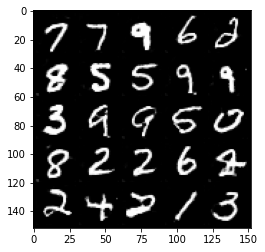

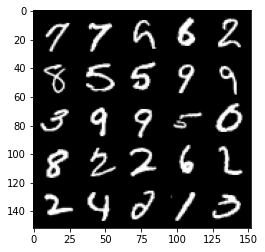

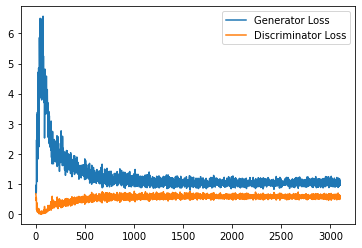

Step 62500: Generator loss: 1.052584327340126, discriminator loss: 0.5815133192539215


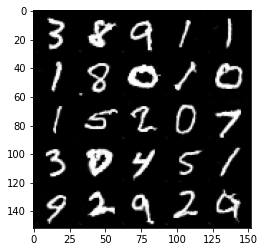

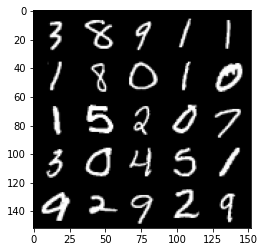

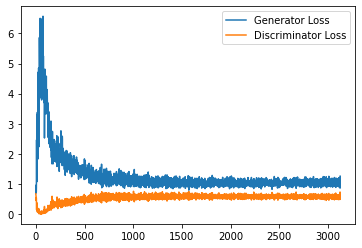

Step 63000: Generator loss: 1.0445765699148177, discriminator loss: 0.587831170141697


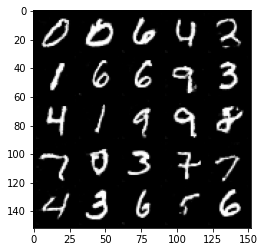

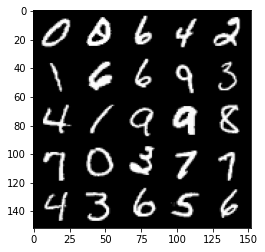

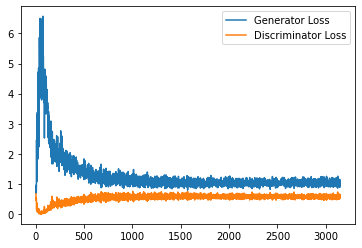

Step 63500: Generator loss: 1.0285471136569977, discriminator loss: 0.5834061210751533


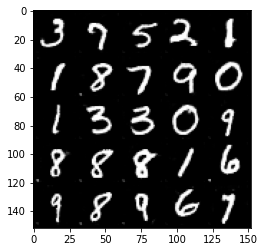

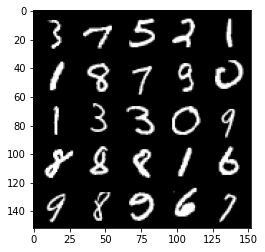

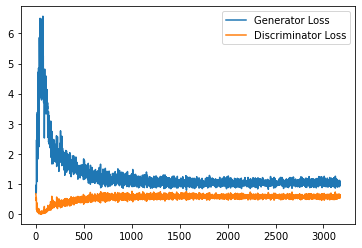

Step 64000: Generator loss: 1.0373070576190948, discriminator loss: 0.5835574868321419


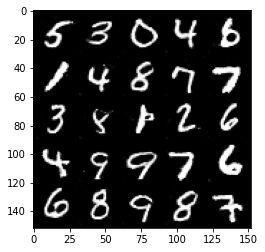

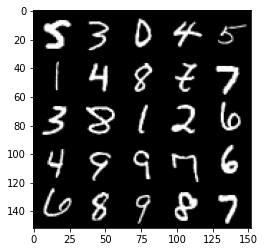

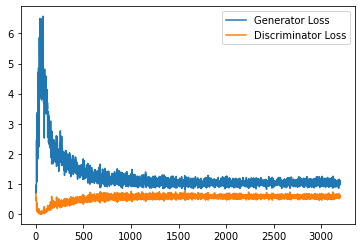

Step 64500: Generator loss: 1.0324535813331603, discriminator loss: 0.5870012018680573


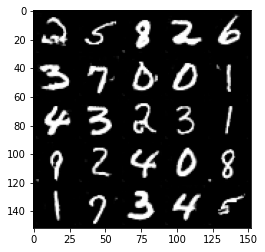

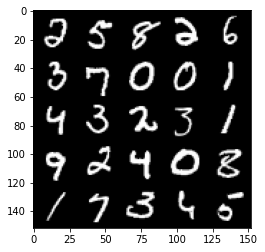

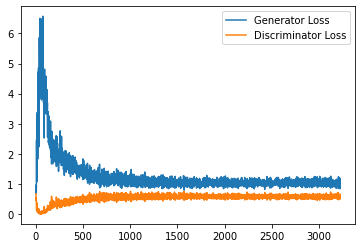

Step 65000: Generator loss: 1.0474462604522705, discriminator loss: 0.5819076977968216


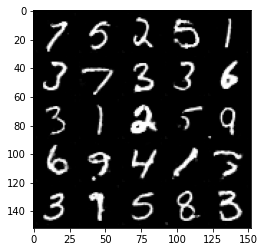

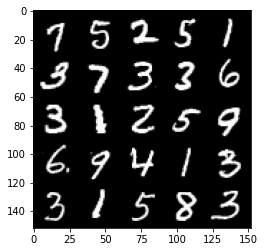

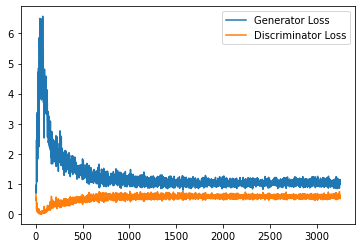

Step 65500: Generator loss: 1.0199089852571488, discriminator loss: 0.5878636911511421


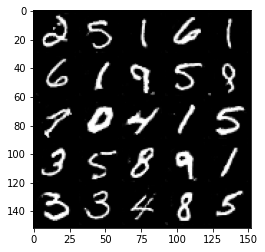

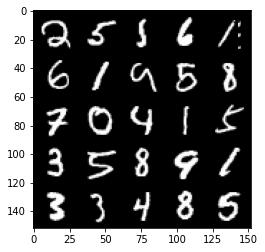

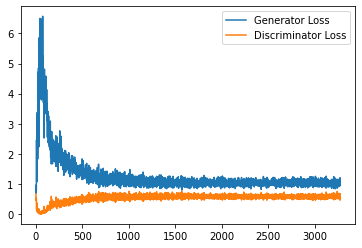

Step 66000: Generator loss: 1.0634923915863037, discriminator loss: 0.581733682513237


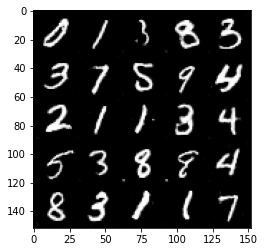

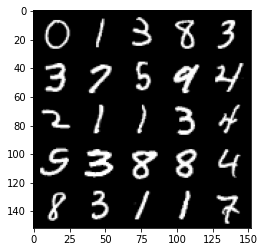

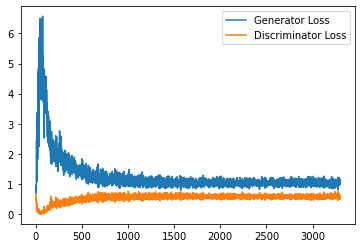

Step 66500: Generator loss: 1.0486083513498305, discriminator loss: 0.5850083566308022


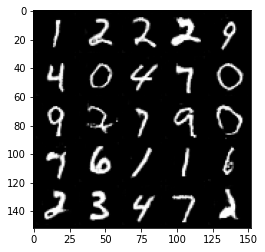

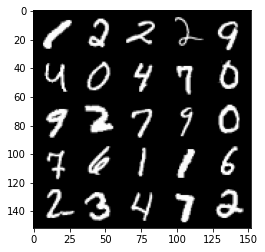

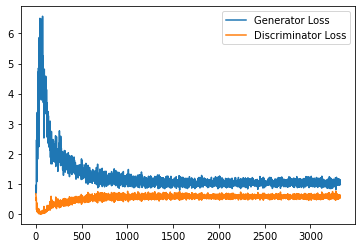

Step 67000: Generator loss: 1.0419179384708404, discriminator loss: 0.5834594993591309


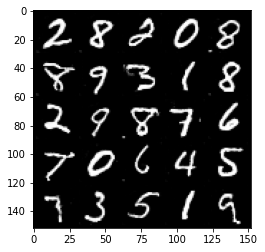

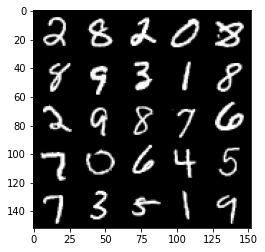

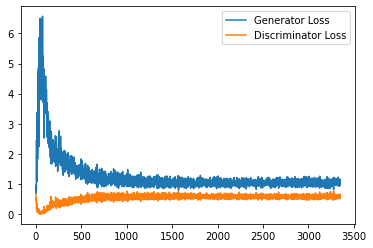

Step 67500: Generator loss: 1.0153620699644088, discriminator loss: 0.5915979316830635


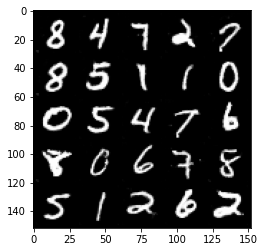

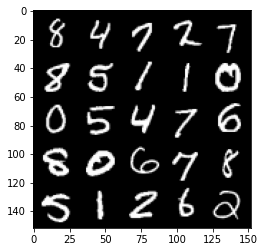

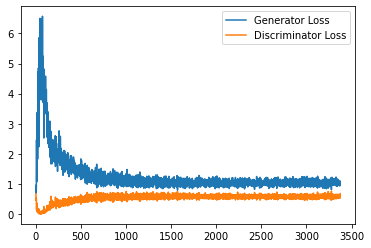

Step 68000: Generator loss: 1.0370097603797912, discriminator loss: 0.588534476518631


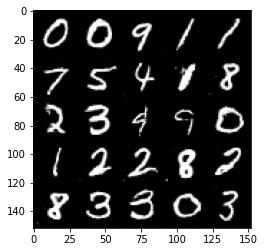

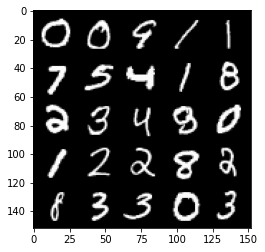

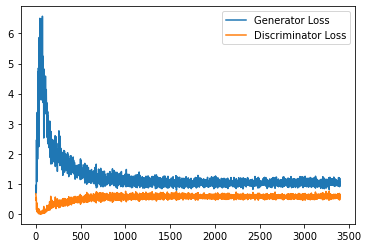

Step 68500: Generator loss: 1.056459863781929, discriminator loss: 0.5859981775283813


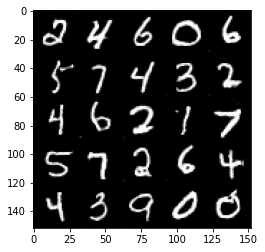

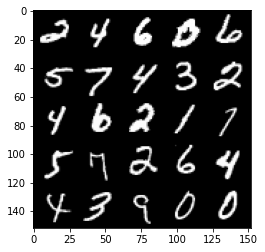

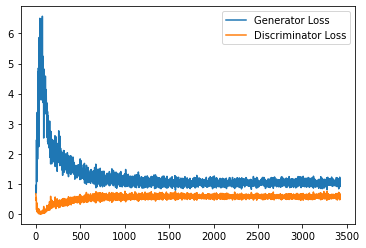

Step 69000: Generator loss: 1.0394859255552291, discriminator loss: 0.5897114326953888


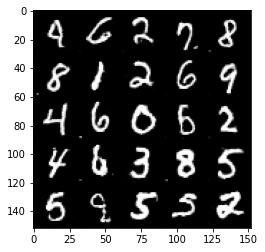

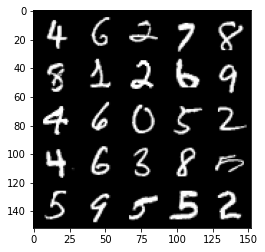

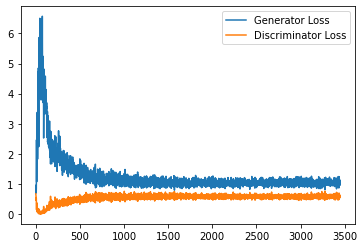

Step 69500: Generator loss: 1.0401809831857682, discriminator loss: 0.5808113697767258


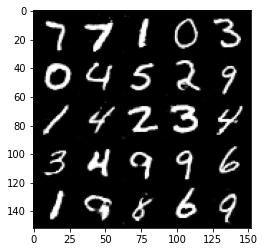

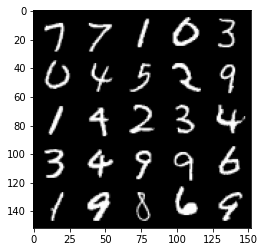

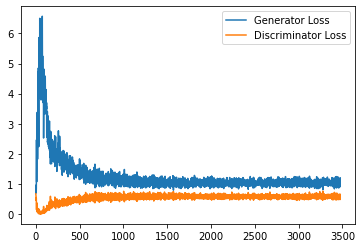

Step 70000: Generator loss: 1.0251558157205582, discriminator loss: 0.5974818669557571


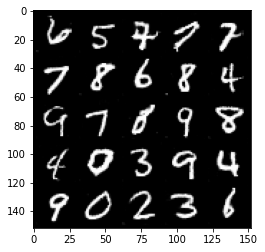

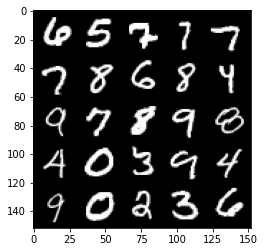

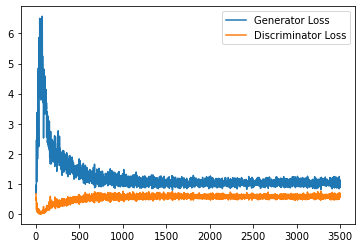

Step 70500: Generator loss: 1.0361746102571487, discriminator loss: 0.5852227693200112


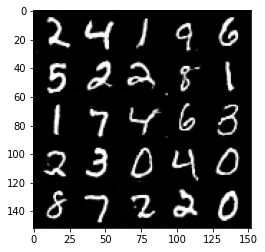

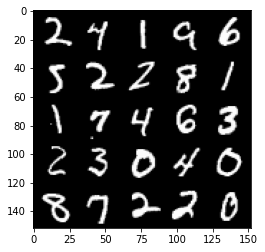

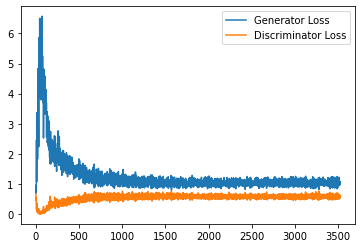

Step 71000: Generator loss: 1.0306946483850479, discriminator loss: 0.586888240814209


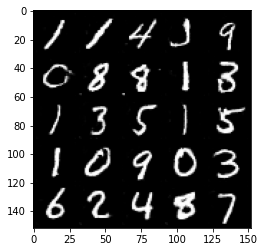

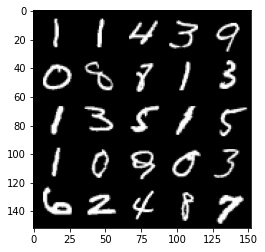

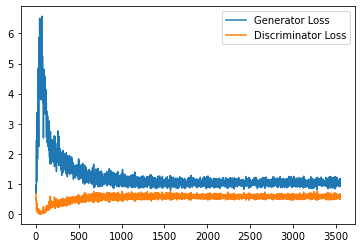

Step 71500: Generator loss: 1.0371307888031005, discriminator loss: 0.5859751505255699


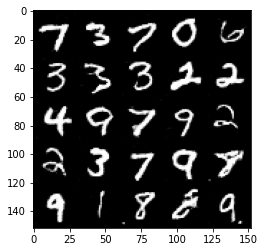

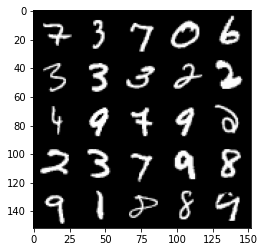

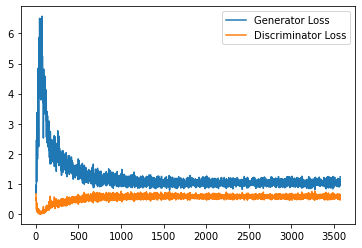

Step 72000: Generator loss: 1.0388738013505936, discriminator loss: 0.598951966047287


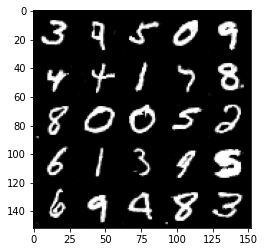

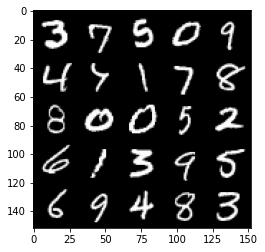

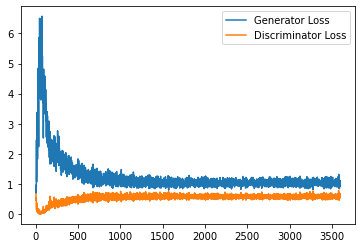

Step 72500: Generator loss: 1.0333345228433608, discriminator loss: 0.58788436460495


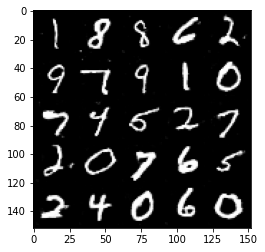

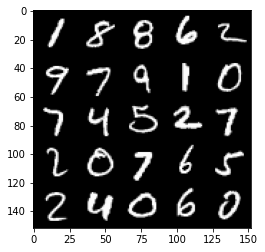

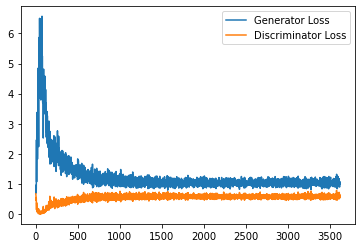

Step 73000: Generator loss: 1.0564956575632096, discriminator loss: 0.5861040014624596


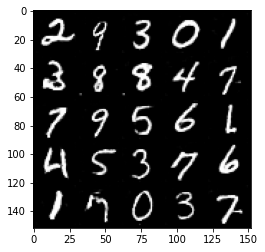

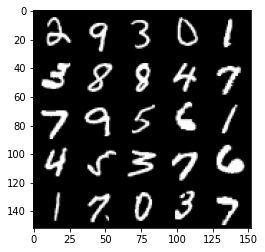

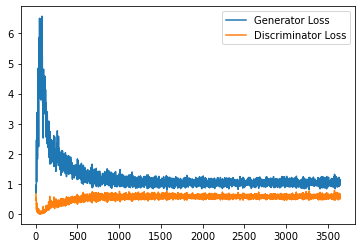

Step 73500: Generator loss: 1.0218278279304505, discriminator loss: 0.5894575894474984


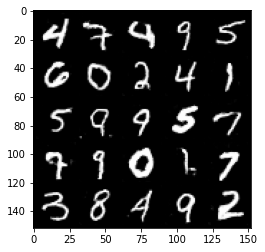

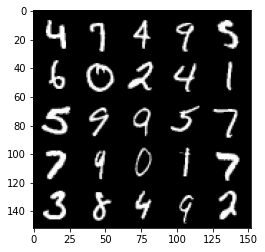

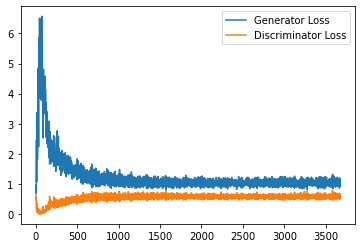

Step 74000: Generator loss: 1.023657699584961, discriminator loss: 0.5959869387745858


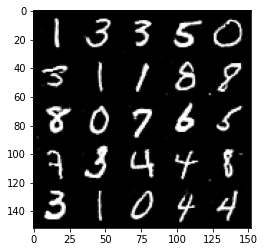

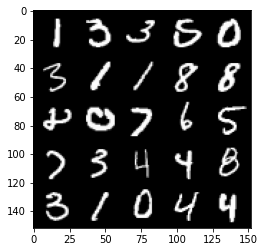

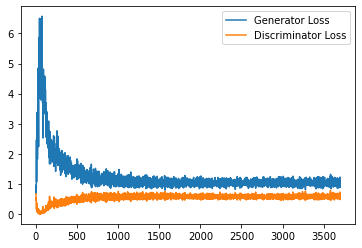

Step 74500: Generator loss: 1.0418355584144592, discriminator loss: 0.5855070114135742


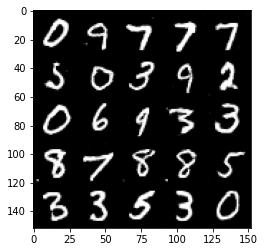

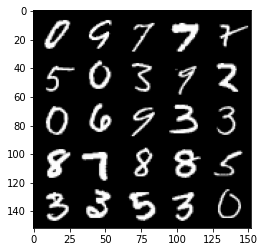

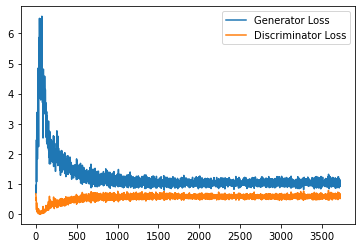

Step 75000: Generator loss: 1.0184793206453324, discriminator loss: 0.5924877563118934


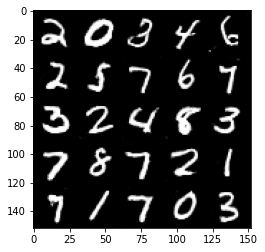

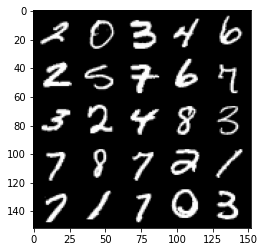

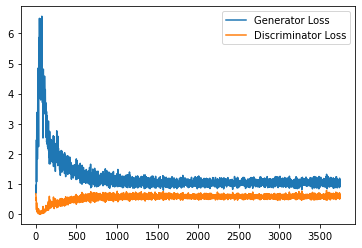

Step 75500: Generator loss: 1.0316974407434463, discriminator loss: 0.5863465959429741


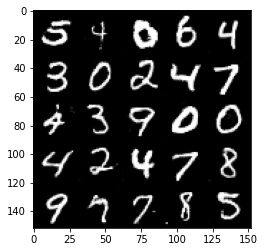

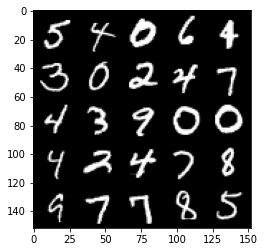

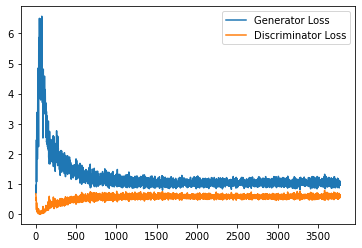

Step 76000: Generator loss: 1.0360442315340042, discriminator loss: 0.5957741976976395


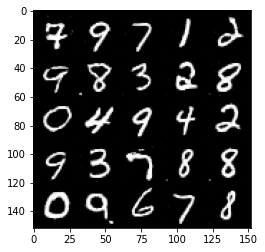

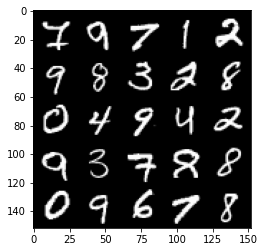

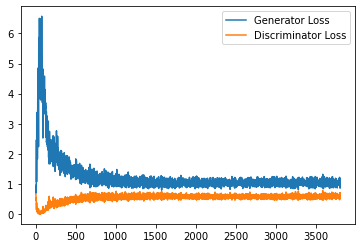

Step 76500: Generator loss: 1.0250640324354172, discriminator loss: 0.5941490362286568


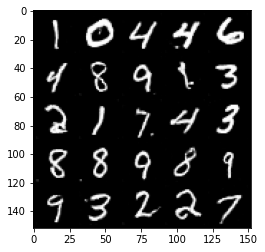

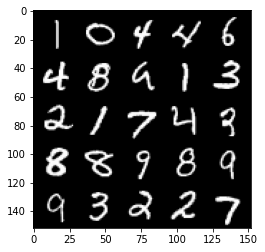

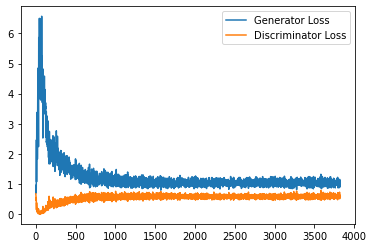

Step 77000: Generator loss: 1.0235228855609895, discriminator loss: 0.5910340449810028


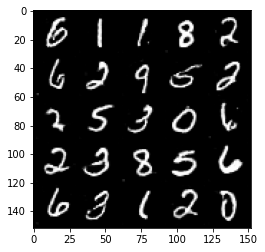

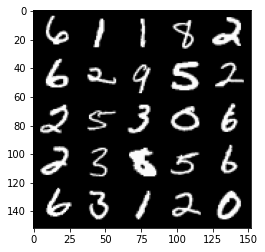

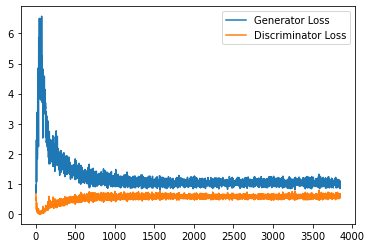

Step 77500: Generator loss: 1.0202994242906571, discriminator loss: 0.5927507539987564


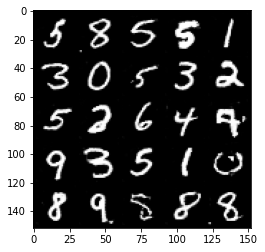

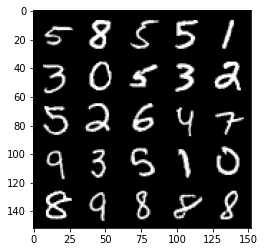

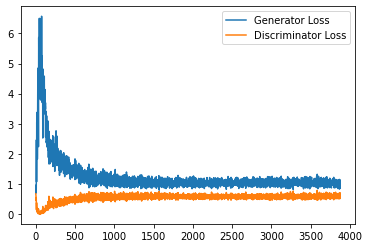

Step 78000: Generator loss: 1.0132825479507446, discriminator loss: 0.5849815324544907


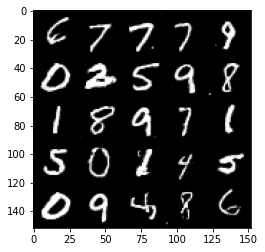

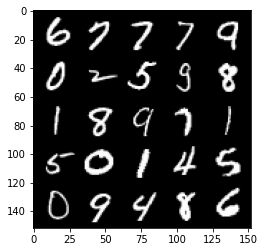

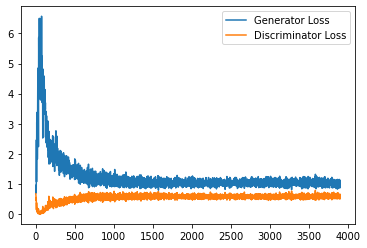

Step 78500: Generator loss: 1.036643203496933, discriminator loss: 0.5889344313144684


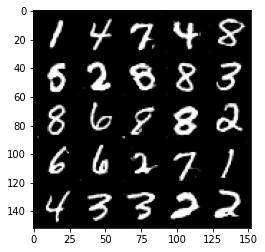

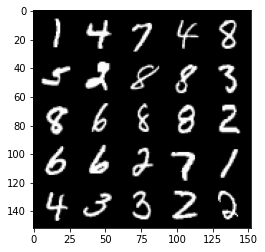

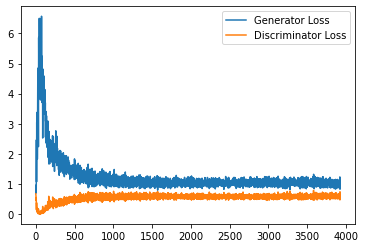

Step 79000: Generator loss: 1.0302158128023147, discriminator loss: 0.5939846749901772


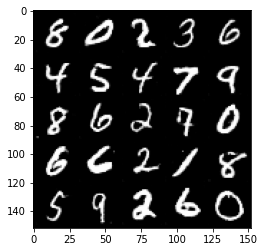

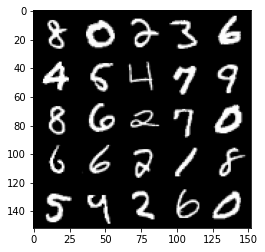

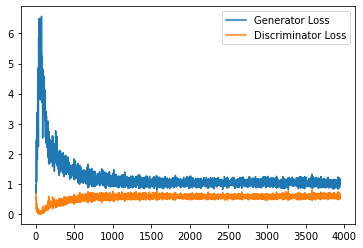

Step 79500: Generator loss: 1.023228162407875, discriminator loss: 0.5952703248262405


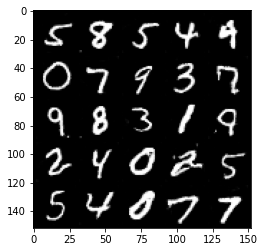

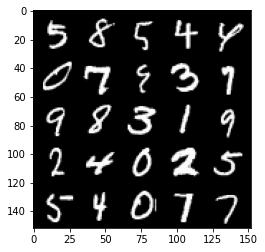

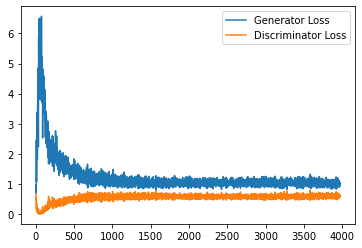

Step 80000: Generator loss: 1.0220179711580277, discriminator loss: 0.5973397420048714


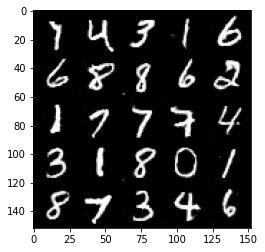

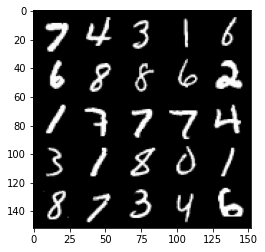

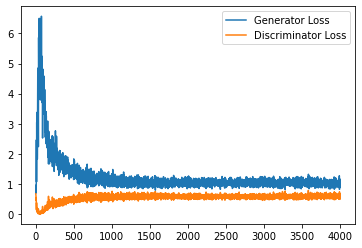

Step 80500: Generator loss: 1.0294002157449722, discriminator loss: 0.5886905197501182


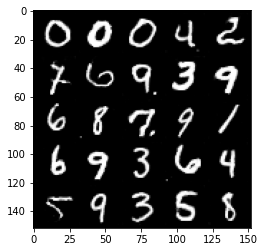

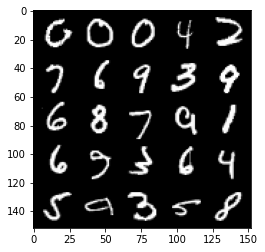

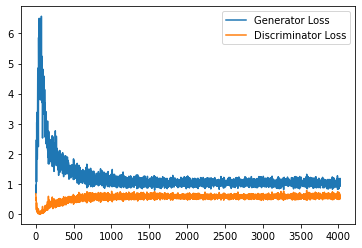

Step 81000: Generator loss: 1.0248248654603958, discriminator loss: 0.5975573252439499


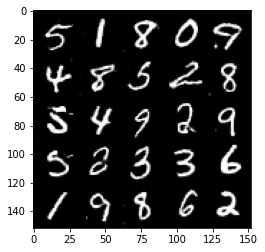

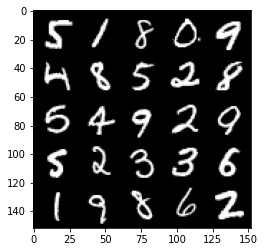

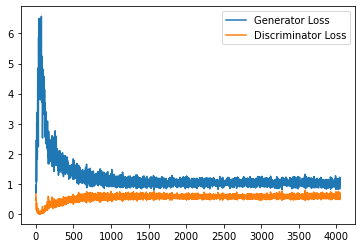

Step 81500: Generator loss: 1.0216959555149079, discriminator loss: 0.5939770364165307


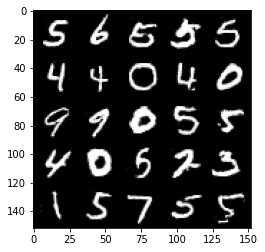

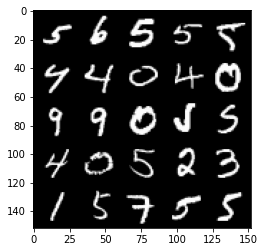

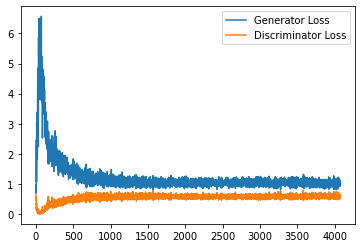

Step 82000: Generator loss: 1.0041984230279923, discriminator loss: 0.597936133146286


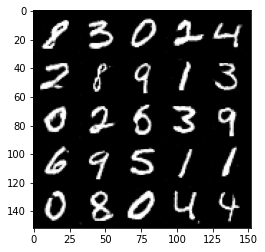

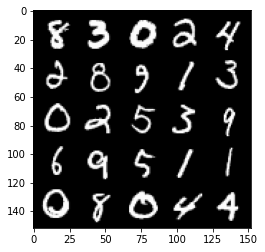

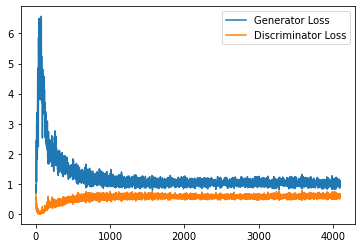

Step 82500: Generator loss: 1.0200815507173537, discriminator loss: 0.5949411485791206


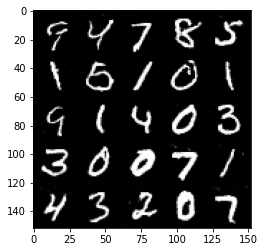

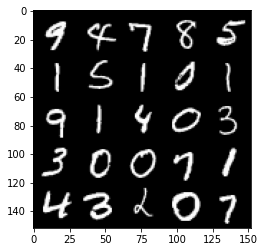

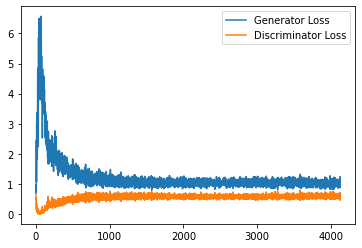

Step 83000: Generator loss: 1.0114131127595902, discriminator loss: 0.599160413980484


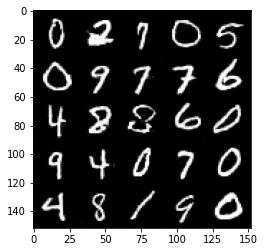

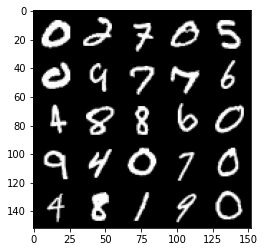

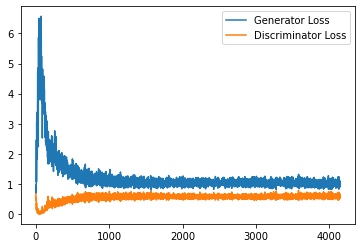

Step 83500: Generator loss: 1.0314786257743835, discriminator loss: 0.5928205433487892


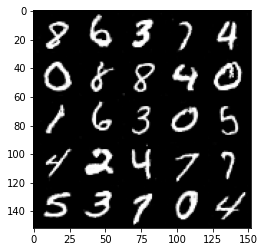

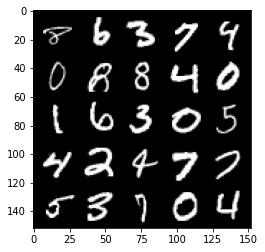

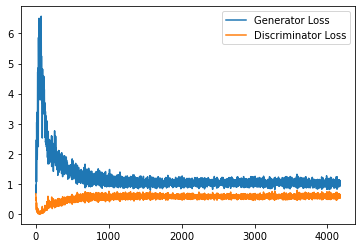

Step 84000: Generator loss: 1.027779882311821, discriminator loss: 0.5927745099663735


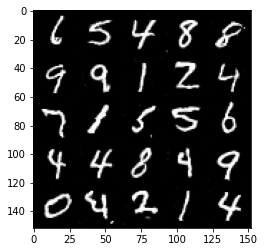

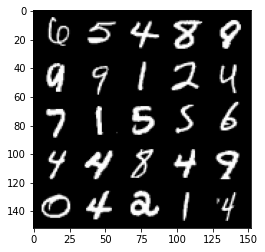

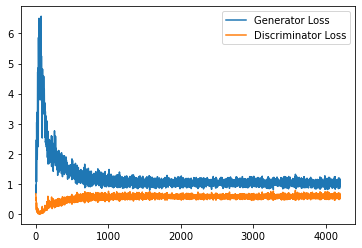

Step 84500: Generator loss: 1.0462892639636994, discriminator loss: 0.5948437451720238


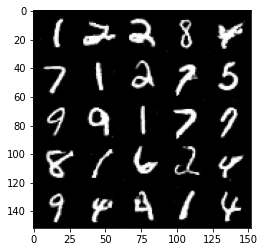

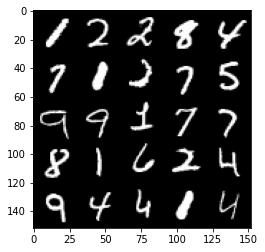

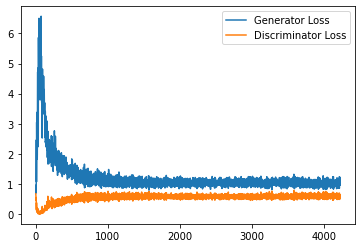

Step 85000: Generator loss: 1.0179227838516236, discriminator loss: 0.5986624499559402


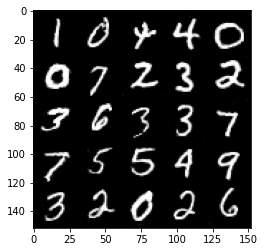

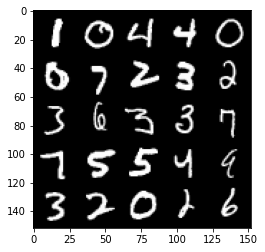

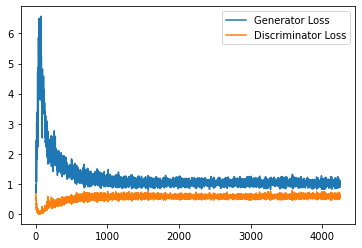

Step 85500: Generator loss: 1.0201936398744582, discriminator loss: 0.5906401816606521


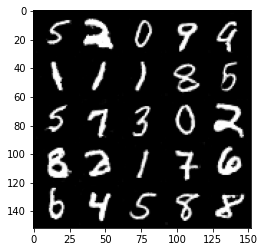

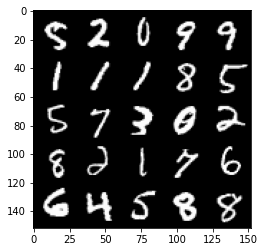

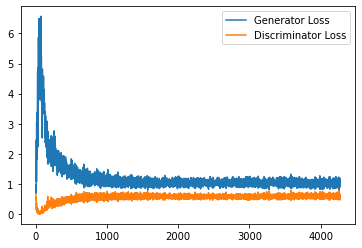

Step 86000: Generator loss: 1.0238584326505662, discriminator loss: 0.5942663094401359


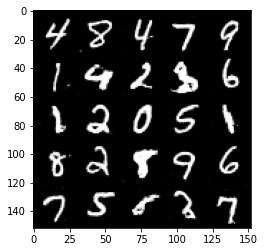

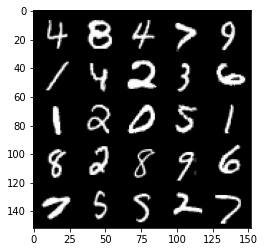

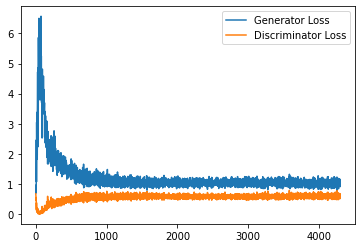

Step 86500: Generator loss: 1.0362697377204895, discriminator loss: 0.5963241299986839


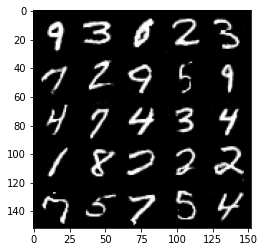

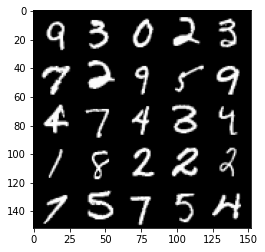

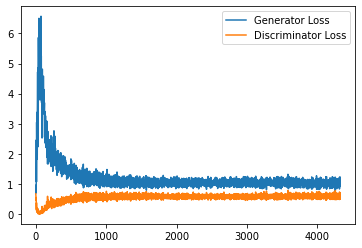

Step 87000: Generator loss: 1.0208473122119903, discriminator loss: 0.6006980525255203


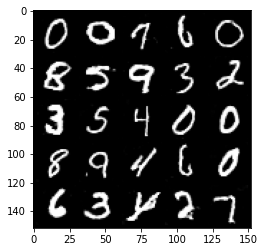

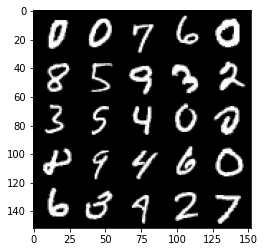

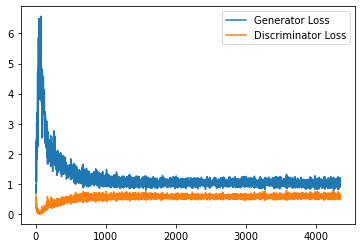

Step 87500: Generator loss: 1.0082176265716554, discriminator loss: 0.6013685436844826


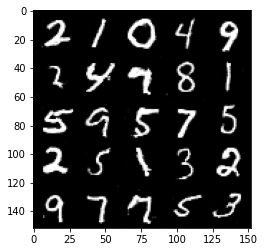

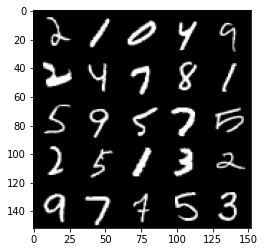

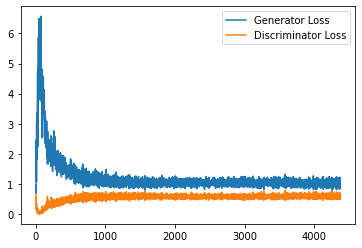

Step 88000: Generator loss: 1.0085057805776596, discriminator loss: 0.5973577217459679


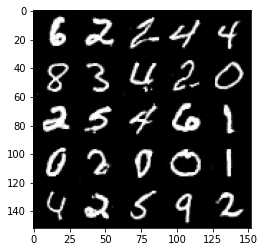

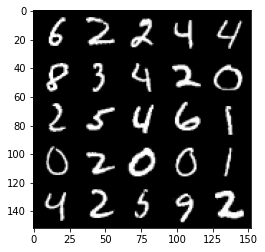

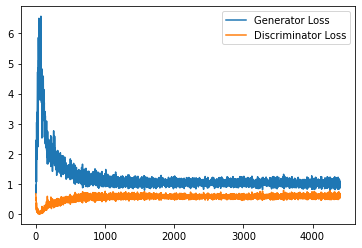

Step 88500: Generator loss: 1.0030471607446672, discriminator loss: 0.5979750154018402


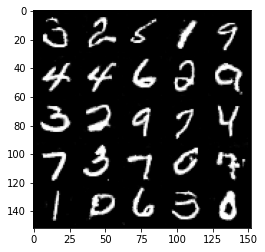

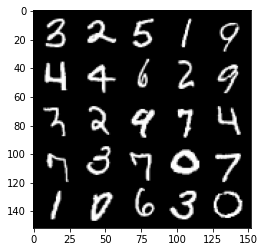

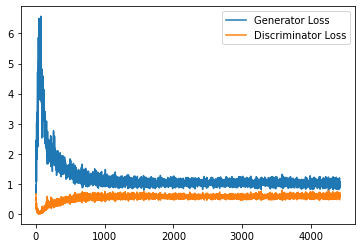

Step 89000: Generator loss: 1.0229425930976868, discriminator loss: 0.5968629225492478


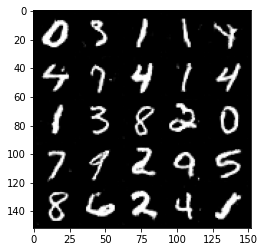

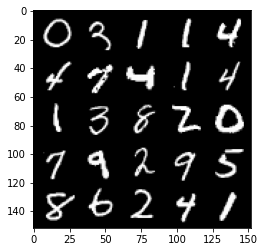

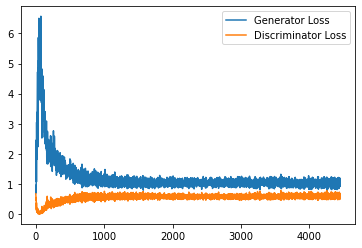

Step 89500: Generator loss: 1.0274077702760696, discriminator loss: 0.5953578678369522


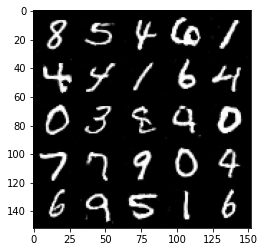

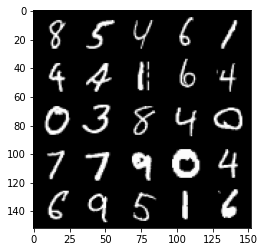

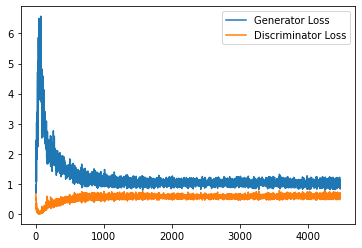

Step 90000: Generator loss: 1.0250090630054474, discriminator loss: 0.5976373934149742


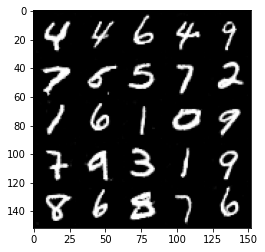

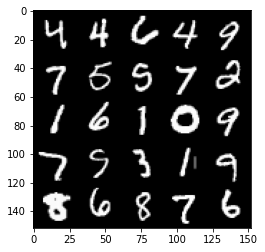

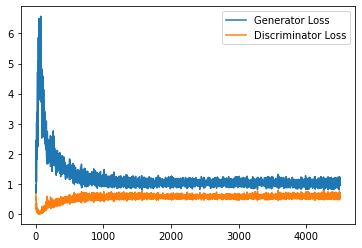

Step 90500: Generator loss: 1.0319226685762406, discriminator loss: 0.5951237015724182


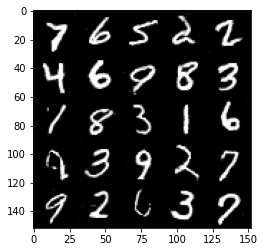

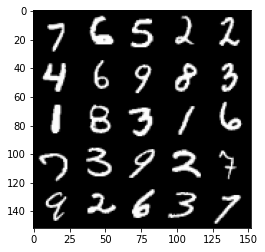

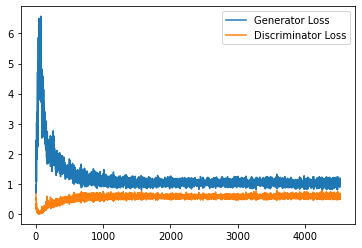

Step 91000: Generator loss: 1.0156526079177857, discriminator loss: 0.599416403234005


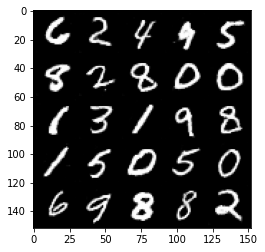

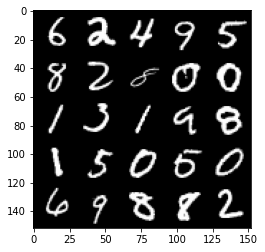

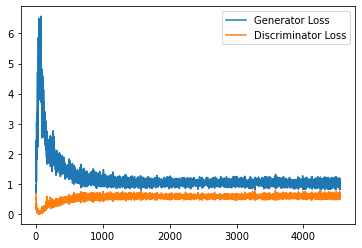

Step 91500: Generator loss: 1.0042719339132309, discriminator loss: 0.5963180550932884


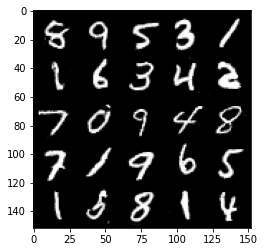

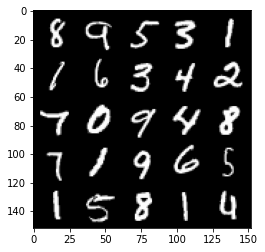

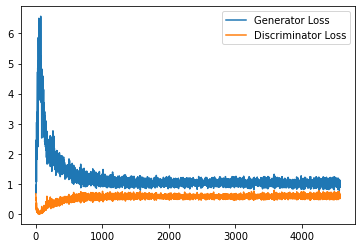

Step 92000: Generator loss: 1.0076039530038834, discriminator loss: 0.5952863824367524


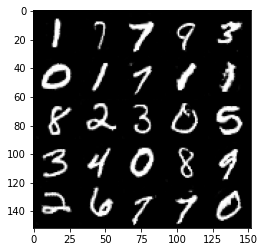

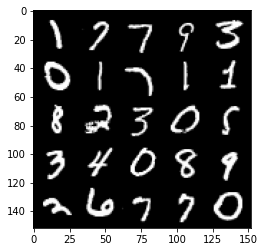

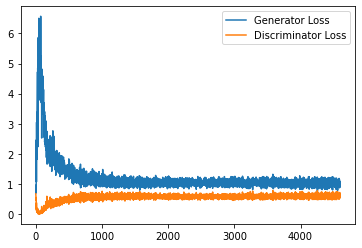

Step 92500: Generator loss: 1.0240218278169633, discriminator loss: 0.5924473893046379


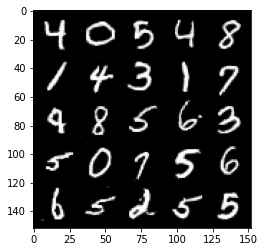

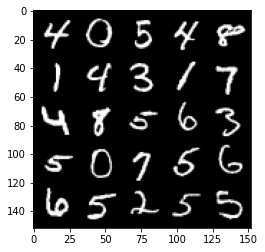

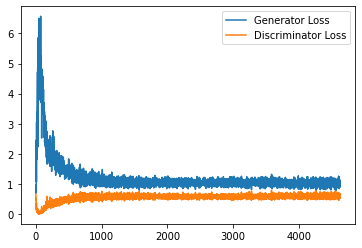

Step 93000: Generator loss: 1.0131758006811142, discriminator loss: 0.5974525909423828


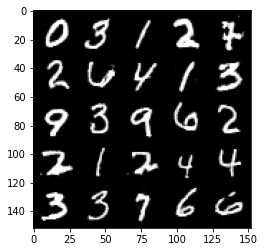

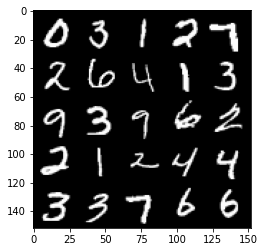

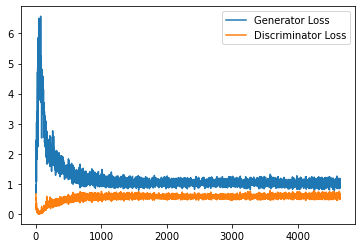

Step 93500: Generator loss: 1.0299907207489014, discriminator loss: 0.6028509808778763


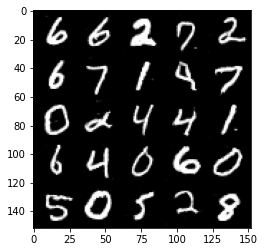

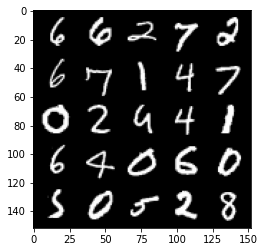

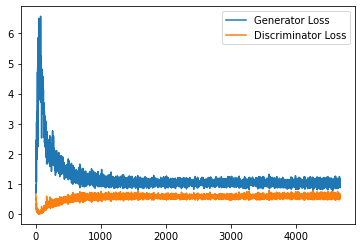

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise , one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake , image_one_hot_labels).detach()
        real_image_and_labels = combine_vectors(real , image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

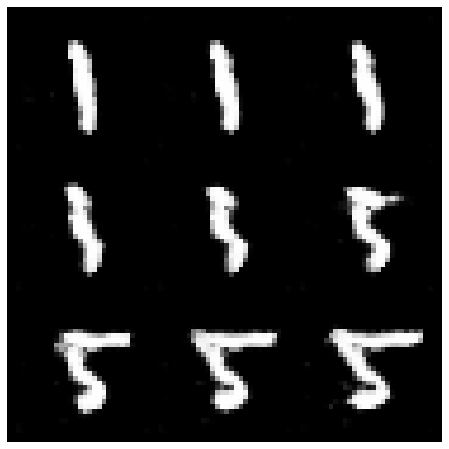

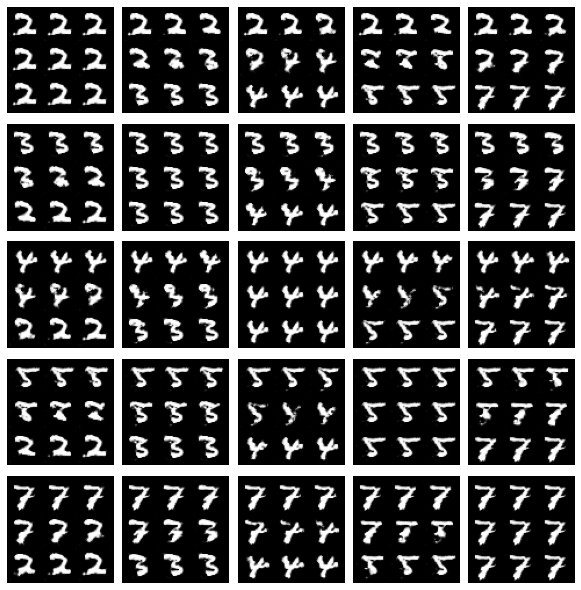

In [16]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

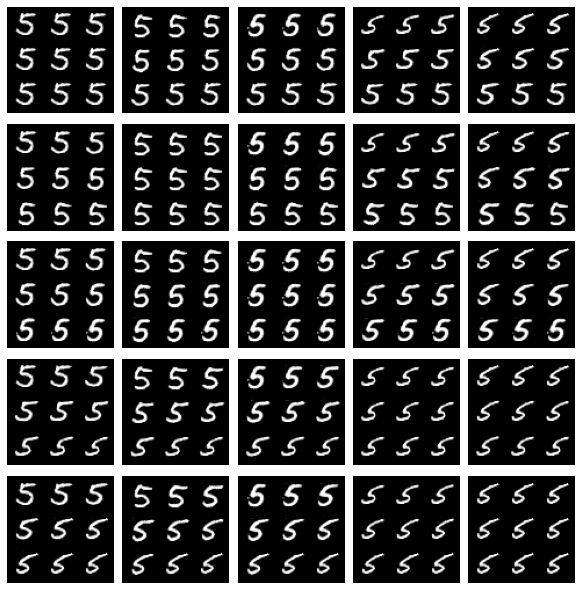

In [21]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()